# Goal

This notebook checks model generalization performance on other dsets.

**With gratitude to**:
- https://github.com/mattiaspaul/OBELISK
-  https://github.com/kbressem/faimed3d/blob/main/examples/3d_segmentation.md

In [1]:
import torch
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

%load_ext autoreload
%autoreload 2

from pathlib import Path

import SimpleITK as sitk
import pandas as pd
import numpy as np

import seaborn as sns

from fastai              import *
from fastai.torch_basics import *
from fastai.basics       import *
from fastai.distributed  import *

# Learner
import gc
gc.collect()

from helpers.losses                import dice_score
from helpers.items_constants       import *
from helpers.transforms_simplified import *
from helpers.general            import rm_prefix, get_param, get_param_default,rm_prefix, modelfn2dict, torch2sitk, sitk2torch
from helpers.model_loss_choices import get_model, get_loss
from helpers.viz                import get_mid_idx, viz_axis, viz_compare_outputs
from helpers.preprocess         import batch_get_bbox, mask2bbox
from helpers.postprocess        import get_largest_connected_component, eval_measure, eval_lcc

cuda:0
Full lbl items: 335
Removed 2 weird, new total lbl items: 333
train, valid, test 201 66 66 total 333
Cross label items:  418
All label items:  751 (abide (333) + cross_lbl (418))
Test label items:  484 (test (66) + cross_lbl (418))


In [2]:
# POST LCC DF DICT

# Items as dict 
from pathlib import Path
from helpers.items_constants import *

#items  = all_test_lbl_items
items = all_test_lbl_items #ppmi, icmb, adni, aibl, abvib, test_items
itemsd = getd(items)

def is_recent(model_fn):
    dates = [f"Aug_0{x}"  for x in range(3,10)]
    dates += [f"Aug_1{x}" for x in range(0,10)]
    dates += [f"Aug_2{x}" for x in range(0,10)]
    dates += [f"Aug_3{x}" for x in range(0,10)]
    return any([date in str(model_fn) for date in dates])


model_fns = sorted(Path(run_src).iterdir(), key=os.path.getmtime, reverse=True)

done = [str(model_fn) 
        for model_fn in model_fns 
        if os.path.isfile(f"{str(model_fn)}/post_lcc_df.pkl") and is_recent(model_fn)
       ]
#print(*rm_prefix(done, prefix=run_src, do_sort=True), sep="\n")
print(f"DONE: {len(done)}")

post_df_dict = {}

for done_fn in done:
    model_name = Path(done_fn).name
    #print(model_name)
    model_src = f"{run_src}/{model_name}"
    check_post_df  = pd.read_pickle(f"{model_src}/post_lcc_df.pkl")
    check_pre_df   = pd.read_pickle(f"{model_src}/pre_lcc_df.pkl")
    #check_stats_df = pd.read_pickle(f"{model_src}/stats_df.pkl")
    
    #check_stats_df = check_stats_df.style.set_caption(f"{model_name}")

    post_df_dict[model_name] = check_post_df
    
    if len(check_post_df) != len(itemsd):
        print(done_fn)
        print("Len", len(check_post_df))
        print("*" * 50)
    #display(check_post_df)
    #display(check_pre_df)
    #display(check_stats_df)

DONE: 308


In [3]:
print(*rm_prefix(done, prefix=run_src, do_sort=True), sep="\n")

model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_False_do_flip_True_bs_2_epochs_60_time_1628202024_Thu_Aug_05_2021_hr_18_min_20
model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_False_do_flip_True_bs_2_epochs_60_time_1628436502_Sun_Aug_08_2021_hr_11_min_28
model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_False_do_flip_True_bs_2_epochs_60_time_1628447321_Sun_Aug_08_2021_hr_14_min_28
model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_False_do_flip_True_bs_2_epochs_60_time_1628493195_Mon_Aug_09_2021_hr_03_min_13
model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_False_do_flip_True_bs_2_epochs_60_time_1628562710_Mon_Aug_09_2021_hr_22_min_31
model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_False_do_flip_True_bs_2_epochs_60_time_1628659646_Wed_Aug_11_2021_hr_01_min_27
model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_False_do_flip_True_bs_2_epochs_60_time_1628756724_Thu_Aug_12_2021_hr_04_min_25
model_CONDSEG_loss_B

In [4]:
#from helpers.general import rm_prefix, cut
#print(*rm_prefix([str(s) for s in most_recent], prefix=run_src), sep="\n")

#most_recent = sorted([Path(f"{run_src}/{key}") for key in list(post_df_dict.keys())], key=os.path.getmtime)
#print(*rm_prefix([str(s) for s in most_recent], prefix=run_src), sep="\n")

In [5]:
models_to_ensemble = [
    # UNET BCE, DICE (SIMPLE)
    "model_UNET3D_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627971506_Tue_Aug_03_2021_hr_02_min_18",
    "model_UNET3D_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628389599_Sat_Aug_07_2021_hr_22_min_26",
    
    # VNET BCE, DICE (SIMPLE)
    "model_VNET_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628677940_Wed_Aug_11_2021_hr_06_min_32",
    "model_VNET_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628463798_Sun_Aug_08_2021_hr_19_min_03",
    
    # CONDSEG BCE, DICE (SIMPLE)
    "model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628302341_Fri_Aug_06_2021_hr_22_min_12",
    "model_CONDSEG_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628658906_Wed_Aug_11_2021_hr_01_min_15",
    
    # OBELISK 96 BCE, DICE (SIMPLE)
    "model_OBELISKHYBRID_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628405192_Sun_Aug_08_2021_hr_02_min_46",
    "model_OBELISKHYBRID_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628436691_Sun_Aug_08_2021_hr_11_min_31",
    
    # OBELISK 144 BCE, DICE (SIMPLE)
    "model_OBELISKHYBRID_loss_BCE_loss_full_res_144_pixdim_1.0_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628312574_Sat_Aug_07_2021_hr_01_min_02",
    "model_OBELISKHYBRID_loss_DICE_loss_full_res_144_pixdim_1.0_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628310872_Sat_Aug_07_2021_hr_00_min_34",    
    # UNETR
    "model_UNETR_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628745179_Thu_Aug_12_2021_hr_01_min_12",
    "model_UNETR_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628651501_Tue_Aug_10_2021_hr_23_min_11",
]

models_to_ensemble_all = models_to_ensemble

models_to_ensemble_names = ["UNET BCE", "UNET DICE", 
                            "VNET BCE", "VNET DICE", 
                            "CONDSEG BCE", "CONDSEG DICE",
                            "OBELISK 96 BCE", "OBELISK  DICE", 
                            "OBELISK 144 BCE", "OBELISK 144 DICE", 
                            "UENTR BCE", "UNETR DICE", 
                           ]
models_names_dict = dict(zip(models_to_ensemble_names, models_to_ensemble))

my_choice_ensemble = ["UNET BCE", "UNET DICE", 
                            "VNET BCE", "VNET DICE", 
                            "CONDSEG BCE", "CONDSEG DICE",
#                             "OBELISK 96 BCE", "OBELISK  DICE", 
#                             "OBELISK 144 BCE", "OBELISK 144 DICE", 
#                             "UENTR BCE", "UNETR DICE", 
                    ]

models_to_ensemble = [models_names_dict[name] for name in my_choice_ensemble]
print(f"My choice Ensemble {len(models_to_ensemble)}", *models_to_ensemble, sep="\n")

My choice Ensemble 6
model_UNET3D_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627971506_Tue_Aug_03_2021_hr_02_min_18
model_UNET3D_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628389599_Sat_Aug_07_2021_hr_22_min_26
model_VNET_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628677940_Wed_Aug_11_2021_hr_06_min_32
model_VNET_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628463798_Sun_Aug_08_2021_hr_19_min_03
model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628302341_Fri_Aug_06_2021_hr_22_min_12
model_CONDSEG_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628658906_Wed_Aug_11_2021_hr_01_min_15


In [6]:
# inputs, labels. Check that the order matches.

# create batches
bs        = 5
batches = [itemsd[i:min(i+bs, len(itemsd))] for i in range(0,len(itemsd),bs)]
ranges  = [range(i,min(i+bs, len(itemsd))) for i in range(0,len(itemsd),bs)]

# get inputs, labels of first 5
full_res = tuple(96 for _ in range(3)) # 144
pixdim   = tuple(1.5 for _ in range(3))
do_condseg = False

#load labels
val_str = f"full_res_{full_res[0]}_pixdim_{pixdim[0]}_do_condseg_{do_condseg}"
transformed_labels_src = f"{data_src}/saved_transformed_labels/{val_str}"

def is_obelisk_144(fn):
    return "OBELISK" in str(fn) and "full_res_144_pixdim_1.0" in str(fn)

i = 0
    
# get stored inputs, labels
with open(f"{transformed_labels_src}/transformed_labels_batch_{i}_bs_{bs}.pkl", 'rb') as handle:
    data = pickle.load(handle)

inputs, labels = zip(*data) # [(img,lbl), (img,lbl)] => imgs, labels
inputs = torch.stack(inputs, dim=0)
labels = torch.stack(labels, dim=0)
inputs = inputs.to(device)
print("inputs", inputs.shape, "labels", labels.shape, len(labels))

# choose fn
for fn in models_to_ensemble:
    print("*"*50); print(fn)

    # dices stored from dataframe
    metric = "dice"
    stored_dices = post_df_dict[fn][metric].values[0:5]

    # get stored predictions
    model_name = Path(fn).name

    start_src = f"{run_src}/{model_name}/to_96_" if is_obelisk_144(fn) else f"{run_src}/{model_name}/"
    with open(f"{start_src}preds_batch_{i}_bs_{bs}.pkl", 'rb') as handle:
        stored_preds = pickle.load(handle)
        
    # to tensor
    if is_obelisk_144(fn):
        stored_preds = [torch.tensor(pred) for pred in stored_preds]

    # recalculate preds
    _, stored_preds_post_metrics = zip(*[eval_lcc(labels[i], stored_preds[i])
                                          for i in range(bs)
                                         ])

    recalc_dices = [d["dice"] for d in stored_preds_post_metrics]
    print(*list(zip(recalc_dices, stored_dices)), sep=", ")

#val_str = "full_res_144_pixdim_1.0_do_condseg_False"
#val_str = "full_res_96_pixdim_1.5_do_condseg_False"

inputs torch.Size([5, 1, 96, 96, 96]) labels torch.Size([5, 1, 96, 96, 96]) 5
**************************************************
model_UNET3D_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627971506_Tue_Aug_03_2021_hr_02_min_18
(0.8859430846491426, 0.8859430846491426), (0.8502285245517404, 0.8502285245517404), (0.8883544020583957, 0.8883544020583957), (0.7410177017000643, 0.7410177017000643), (0.7420462909953383, 0.7420462909953383)
**************************************************
model_UNET3D_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628389599_Sat_Aug_07_2021_hr_22_min_26
(0.8910776875637784, 0.8910776875637784), (0.8365456821026283, 0.8365456821026283), (0.8871586915382536, 0.8871586915382536), (0.7217511576162127, 0.7217511576162127), (0.756554928642549, 0.756554928642549)
**************************************************
model_VNET_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_

In [7]:
# # test Pipeline

# # standard: 96 full res, pixdim 1.5
# # full_res = tuple(96 for _ in range(3)) # 144
# # pixdim   = tuple(1.5 for _ in range(3))
# # do_condseg = False

# train_itemsd = getd(train_items) # for condseg atlas choice

# val_tfm_dict = {}
# for condseg_bool in (True, False):
#     for full_res,pixdim in ((96,1.5),(144,1.0)):
#         val_tfm_dict[f"full_res_{full_res}_pixdim_{pixdim}_do_condseg_{condseg_bool}"] = \
#             get_train_valid_transforms(items=train_itemsd, pixdim=pixdim, full_res=full_res, do_condseg=condseg_bool)[1]
        
# val_tfms = val_tfm_dict["full_res_96_pixdim_1.5_do_condseg_False"]        
# test_data = Pipeline(val_tfms)(itemsd[0:5])

In [8]:
# models_to_ensemble = [
#     # UNET VNET DICE
#     "model_UNET3D_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627971508_Tue_Aug_03_2021_hr_02_min_18",
#     "model_VNET_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627978137_Tue_Aug_03_2021_hr_04_min_08",
#     # UNET VNET BCE
#     "model_UNET3D_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627971506_Tue_Aug_03_2021_hr_02_min_18",
#     "model_VNET_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627978233_Tue_Aug_03_2021_hr_04_min_10",
#     # OBELISK DICE BCE
#     "model_OBELISKHYBRID_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627963440_Tue_Aug_03_2021_hr_00_min_04",
#     "model_OBELISKHYBRID_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627963631_Tue_Aug_03_2021_hr_00_min_07",
#     # CONDSEG DICE BCE
#     "model_CONDSEG_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628097973_Wed_Aug_04_2021_hr_13_min_26",
#     "model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628097978_Wed_Aug_04_2021_hr_13_min_26"
# ]

# models_to_ensemble_names = ["UNET DICE", "VNET DICE", 
#                             "UNET BCE", "VNET BCE", 
#                             "OBELISK 96 DICE", "OBELISK 96 BCE", 
#                             "CONDSEG DICE", "CONDESEG BCE"
#                            ]
# models_names_dict = dict(zip(models_to_ensemble_names, models_to_ensemble))

# my_choice_ensemble = ["UNET BCE", "VNET BCE"]
# models_to_ensemble = [models_names_dict[name] for name in my_choice_ensemble]

# print(f"My choice Ensemble {len(models_to_ensemble)}", *models_to_ensemble, sep="\n")

In [9]:
def rename2(fn):
    model_name2 = Path(fn).name
    model_type2 = get_param(model_name2, "model_", "_loss")

    if "loss_bs" in model_name:
        loss_type2  = get_param(model_name2, "loss_", "_bs")
    else:
        loss_type2  = get_param(model_name2, "loss_", "_full_res")

    full_res2   = get_param_default(model_name2, "full_res_", "_pixdim", 96)
    pixdim2     = get_param_default(model_name2, "pixdim_", "_do_simple", 1.5)
    do_simple2  = get_param_default(model_name2, "do_simple_", "_do_flip", False)
    do_flip2    = get_param_default(model_name2, "do_flip_", "_bs", True)
    
    # convert to bool
    do_simple2 = do_simple2 == "True"
    do_flip2   = do_flip2  == "True"
        
    if model_type2 != "OBELISKHYBRID": 
        s = f"{model_type2}" 
        if not do_simple2: 
            s += " (+aug)"
        return s
    else:
        # {model_type2}
        s = f"OBELISK {full_res2}" 
        if not do_simple2: 
            s += " (+aug)"
        return s

In [10]:
# Viz models to ensemble

metric = "dice" # false_pos

# if output doesn't intersect
undefined_val = {"false_pos": 0.0, "false_neg": 1.0}

simple_keys    = [k for k in models_to_ensemble if "do_simple_True" in k]
bce_plot_keys  = [k for k in simple_keys if "BCE_loss" in k]
dice_plot_keys = [k for k in simple_keys if "DICE_loss" in k]

data = [{"model_type": rename2(fn), "loss_type":  "DICE_loss", f"{metric}_score":min(val,1)} 
        for i,fn in enumerate(dice_plot_keys) 
        for val in post_df_dict[fn][metric].values
       ] + \
    [{"model_type":  rename2(fn), "loss_type":  "BCE_loss", f"{metric}_score":min(val,1)} 
        for i,fn in enumerate(bce_plot_keys) 
        for val in post_df_dict[fn][metric].values
       ]

# ensemble_data = \
#     [{"model_type": "ensemble",  "loss_type":  "BCE_loss", f"{metric}_score":val} for val in ensemble_bce_df[metric].values] + \
#     [{"model_type": "ensemble", "loss_type":  "DICE_loss", f"{metric}_score":val} for val in ensemble_dice_df[metric].values] + \
#     [{"model_type": "ensemble",  "loss_type":  "Combined", f"{metric}_score":val} for val in ensemble_all_df[metric].values]

# together_data = pd.DataFrame(data+ensemble_data) 

data_df = pd.DataFrame(data)
#ensemble_data = pd.DataFrame(ensemble_data)

display(data_df.head())

,model_type,loss_type,dice_score
0,UNET3D,DICE_loss,0.891078
1,UNET3D,DICE_loss,0.836546
2,UNET3D,DICE_loss,0.887159
3,UNET3D,DICE_loss,0.721751
4,UNET3D,DICE_loss,0.756555


In [11]:
# fig, ax = plt.subplots(figsize=(12,6))

# ax = sns.boxplot(x="model_type",   y=f"{metric}_score", data=data_df, hue="loss_type", ax=ax)
# ax = sns.swarmplot(x="model_type", y=f"{metric}_score", data=data_df, hue="loss_type", color=".25")

In [12]:
# Ensemble

dice_models_to_ensemble = [fn for fn in models_to_ensemble if "DICE_loss" in fn]
bce_models_to_ensemble  = [fn for fn in models_to_ensemble if "BCE_loss" in fn]

print("Dice models", len(dice_models_to_ensemble), *dice_models_to_ensemble, sep="\n")
print("BCE models", len(bce_models_to_ensemble), *bce_models_to_ensemble, sep="\n")
print(f"All models", len(models_to_ensemble), *models_to_ensemble, sep="\n")

Dice models
3
model_UNET3D_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628389599_Sat_Aug_07_2021_hr_22_min_26
model_VNET_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628463798_Sun_Aug_08_2021_hr_19_min_03
model_CONDSEG_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628658906_Wed_Aug_11_2021_hr_01_min_15
BCE models
3
model_UNET3D_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627971506_Tue_Aug_03_2021_hr_02_min_18
model_VNET_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628677940_Wed_Aug_11_2021_hr_06_min_32
model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628302341_Fri_Aug_06_2021_hr_22_min_12
All models
6
model_UNET3D_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627971506_Tue_Aug_03_2021_hr_02_

In [13]:
import re

# create batches
bs        = 5
batches = [itemsd[i:min(i+bs, len(itemsd))] for i in range(0,len(itemsd),bs)]

def get_model_id(model_fn):
    """ model ids = time string """
    return re.search("(time_\d+)", model_fn).groups(0)[0]

ensemble_name = "_and_".join([get_model_id(model_fn) for model_fn in models_to_ensemble])
print(ensemble_name)

# mkdir
ensemble_src = f"{run_src}/model_ensemble/{ensemble_name}"
Path(ensemble_src).mkdir(parents=True, exist_ok=True)

if not os.path.isfile(f"{ensemble_src}/models_to_ensemble.pkl"):
    with open(f"{ensemble_src}/models_to_ensemble.pkl", 'wb') as handle:
            pickle.dump(models_to_ensemble, handle)

time_1627971506_and_time_1628389599_and_time_1628677940_and_time_1628463798_and_time_1628302341_and_time_1628658906


In [14]:
# # POST PROCESS OBELISK 144 BACK TO 1.5 voxel spacing and center crop to 96

# # convert preds => bilinear interpolation of probabilities
# from monai.transforms import Compose, Spacingd, CenterSpatialCropd
# convert_to_96_tfms = Compose([
#     Spacingd(keys=["pred"], pixdim=(1.5,1.5,1.5), mode=("bilinear")),
#     CenterSpatialCropd(keys=["pred"], roi_size=(96, 96, 96))
# ])

# # REDO OBELISKS
# obelisk_144 = [str(model_fn) 
#         for model_fn in model_fns 
#         if (("OBELISK" in str(model_fn) and "full_res_144_pixdim_1.0" in str(model_fn)) and \
#                 (os.path.isfile(f"{str(model_fn)}/preds_batch_96_bs_5.pkl")) and \
#                 (os.path.isfile(f"{str(model_fn)}/figs/metrics.png")) and \
#                 is_recent(model_fn)
#             )
#        ]

# print(len(obelisk_144), *obelisk_144[0:5], sep="\n")

In [15]:
# start = time.time()

# for model_fn in obelisk_144:
#     model_name = Path(model_fn).name
    
#     for i in range(len(batches)):
        
#         # open pixdim 1.0, full_res 144 preds
#         with open(f"{run_src}/{model_name}/preds_batch_{i}_bs_{bs}.pkl", 'rb') as handle:
#             preds_144 = pickle.load(handle)
            
#         # transform to pixdim 1.5 full_res 96 preds
#         preds_96 = convert_to_96_tfms([{"pred": pred} for pred in preds_144])
        
#         with open(f"{run_src}/{model_name}/to_96_preds_batch_{i}_bs_{bs}.pkl", 'wb') as handle:
#             pickle.dump([d["pred"] for d in preds_96], handle)
            
#         print(preds_144[0].shape, preds_96[0]["pred"].shape, len(preds_96))
        
# elapsed = time.time() - start
# print(f"Elapsed: {elapsed:0.2f} s.")

In [16]:
# not all obelisk have predictions
# for i,model_fn in enumerate(obelisk_144):
#     print(i, model_fn); print("*"*50);
#     print("N files: ", len(os.listdir(model_fn))); print("*"*50);
#     #print(os.listdir(model_fn))

In [17]:
# load ensemble

ensemble_name          = "_and_".join([get_model_id(model_fn) for model_fn in models_to_ensemble])
ensemble_src           = f"{run_src}/model_ensemble/{ensemble_name}"

print(ensemble_name)

# Items as dict 
items  = all_test_lbl_items
itemsd = getd(items)

# create batches
bs        = 5
batches = [itemsd[i:min(i+bs, len(itemsd))] for i in range(0,len(itemsd),bs)]

# load preds
ensemble_all_majority_vote = []
ensemble_bce_majority_vote = []
ensemble_dice_majority_vote = []

start = time.time()
for i in range(len(batches)):
    with open(f"{ensemble_src}/dice_preds_batch_{i}_bs_{bs}.pkl", 'rb') as handle:
        ensemble_dice_majority_vote += pickle.load(handle)

    with open(f"{ensemble_src}/bce_preds_batch_{i}_bs_{bs}.pkl", 'rb') as handle:
        ensemble_bce_majority_vote += pickle.load(handle)

    with open(f"{ensemble_src}/all_preds_batch_{i}_bs_{bs}.pkl", 'rb') as handle:
        ensemble_all_majority_vote += pickle.load(handle)
        
elapsed = time.time() - start
print(f"Elapsed: {elapsed:0.2f} s")

time_1627971506_and_time_1628389599_and_time_1628677940_and_time_1628463798_and_time_1628302341_and_time_1628658906
Elapsed: 9.79 s


In [18]:
# get all ensemble - Elapsed: Elapsed: 204.79 s. =>  4min #590.97 s. => 600 => 10min; Elapsed: 1171.70 s.

get_ensemble = False

# # create batches
# bs        = 5
# batches = [itemsd[i:min(i+bs, len(itemsd))] for i in range(0,len(itemsd),bs)]
def is_obelisk_144(fn):
    return "OBELISK" in str(fn) and "full_res_144_pixdim_1.0" in str(fn)

def load_model_preds(model_name, file_range=range(0,len(batches))):
    # f"{run_src}/{model_name}/to_96_preds_batch_{i}_bs_{bs}.pkl"
    start_src = f"{run_src}/{model_name}/to_96_" if is_obelisk_144(model_name) else f"{run_src}/{model_name}/"
        
    preds = []
    for i in file_range:
        with open(f"{start_src}preds_batch_{i}_bs_{bs}.pkl", 'rb') as handle:
            if is_obelisk_144(model_name):
                preds += [torch.tensor(pred) for pred in pickle.load(handle)]
            else:
                preds += pickle.load(handle)
    return preds

#######################
# get all ensemble
#######################
if get_ensemble:
    start = time.time()

    for i in range(len(batches)):
        # load each models pred (6) for (0,5), (5,10) etc => 30 preds per range
        model_preds_dict = {model_fn:load_model_preds(model_fn, file_range=range(i,i+1)) 
                            for model_fn in models_to_ensemble}

        # get lcc for each of preds
        dice_majority_votes = []
        bce_majority_votes  = []
        all_majority_votes  = []

        for bs_item in range(len(batches[i])):
            ordered_preds = [model_preds_dict[model_name] for model_name in models_to_ensemble]
            all_preds = [(model_fn, get_largest_connected_component(torch2sitk(preds[bs_item].argmax(0).byte()))) 
                         for model_fn, preds in zip(models_to_ensemble, ordered_preds)]

            dice_preds = [preds for model_fn, preds in all_preds if "DICE_loss" in model_fn]
            bce_preds  = [preds for model_fn, preds in all_preds if "BCE_loss" in model_fn]
            all_preds  = [preds for model_fn, preds in all_preds]

            # get majority vote
            labelForUndecidedPixels = 0
            if len(dice_preds) > 0: dice_majority_vote = sitk.LabelVoting(dice_preds, labelForUndecidedPixels)
            if len(bce_preds)  > 0: bce_majority_vote  = sitk.LabelVoting(bce_preds, labelForUndecidedPixels)
            all_majority_vote  = sitk.LabelVoting(all_preds, labelForUndecidedPixels)

            #print(majority_vote.GetSize())
            if len(dice_preds) > 0: dice_majority_votes.append(sitk2torch(dice_majority_vote))
            if len(bce_preds)  > 0: bce_majority_votes.append(sitk2torch(bce_majority_vote))
            all_majority_votes.append(sitk2torch(all_majority_vote))

        # save model outputs
        with open(f"{ensemble_src}/dice_preds_batch_{i}_bs_{bs}.pkl", 'wb') as handle:
            pickle.dump(dice_majority_votes, handle)

        with open(f"{ensemble_src}/bce_preds_batch_{i}_bs_{bs}.pkl", 'wb') as handle:
            pickle.dump(bce_majority_votes, handle)

        with open(f"{ensemble_src}/all_preds_batch_{i}_bs_{bs}.pkl", 'wb') as handle:
            pickle.dump(all_majority_votes, handle)

        # print(len(all_majority_votes))

    elapsed = time.time() - start
    print(f"Elapsed: {elapsed:0.2f} s.")

In [19]:
full_res = tuple(96 for _ in range(3)) # 144
pixdim   = tuple(1.5 for _ in range(3))
do_condseg = False

# load transformed inputs, labels
def get_transformed_inputs_labels():
    val_str = f"full_res_{full_res[0]}_pixdim_{pixdim[0]}_do_condseg_{do_condseg}"
    transformed_labels_src = f"{data_src}/saved_transformed_labels/{val_str}"
    all_data = []
    for i in range(len(batches)):
        with open(f"{transformed_labels_src}/transformed_labels_batch_{i}_bs_{bs}.pkl", 'rb') as handle:
            all_data.append(pickle.load(handle)) # bsx1xfull_res
    return all_data

start = time.time()
all_data = get_transformed_inputs_labels()
elapsed = time.time() - start
print(f"Load transformed inputs/labels. Elapsed: {elapsed:0.2f} s")

#val_str = "full_res_144_pixdim_1.0_do_condseg_False"
#val_str = "full_res_96_pixdim_1.5_do_condseg_False"

Load transformed inputs/labels. Elapsed: 8.99 s


In [20]:
len(all_data), len(all_data[0]), len(all_data[0][0]), all_data[0][0][0].shape, all_data[0][0][1].shape # all data = 97 items, each item has batch size of 5, each item in batch is tuple = (input, label)

(97, 5, 2, torch.Size([1, 96, 96, 96]), torch.Size([1, 96, 96, 96]))

In [21]:
# print("all data = inputs/labels", len(all_data))
print("dice majority vote", len(ensemble_dice_majority_vote), 
      "bce majority vote", len(ensemble_bce_majority_vote), 
      "all majority vote", len(ensemble_all_majority_vote), sep="\n")

dice majority vote
484
bce majority vote
484
all majority vote
484


In [22]:
# get dice scores Elapsed: 107.66 s (2minn) Elapsed: 1206.66 s

# Labels (Transforms)

# for condseg
# train_itemsd = getd(train_items) # for condseg atlas choice

# val_tfm_dict = {}
# for condseg_bool in (True, False):
#     for full_res,pixdim in ((96,1.5),(144,1.0)):
#         val_tfm_dict[f"full_res_{full_res}_pixdim_{pixdim}_do_condseg_{condseg_bool}"] = \
#             get_train_valid_transforms(items=train_itemsd, pixdim=pixdim, full_res=full_res, do_condseg=condseg_bool)[1]

# val_tfms = val_tfm_dict["full_res_96_pixdim_1.5_do_condseg_False"]

# load indiv predictions
def idx2batch_idx(idx):
    for batch_idx_,range_ in enumerate(ranges):
        if idx in range_:
            batch_idx = batch_idx_
            within_batch_idx = idx - range_[0]
            return batch_idx, within_batch_idx

if get_ensemble:
    start = time.time()

    # get dice scores
    ensemble_bce_scores  = []
    ensemble_dice_scores = []
    ensemble_all_scores  = []

    # 1sec per item => 10 min
    for i,item in enumerate(itemsd):
        batch_idx, within_batch_idx = idx2batch_idx(i)
        label = torch2sitk(all_data[batch_idx][within_batch_idx][1].squeeze(0).byte()) # both label and each vote are full_res size
        if len(ensemble_bce_majority_vote)  > 0: ensemble_bce_scores.append(eval_measure(label, torch2sitk(ensemble_bce_majority_vote[i].byte())))
        if len(ensemble_dice_majority_vote) > 0: ensemble_dice_scores.append(eval_measure(label, torch2sitk(ensemble_dice_majority_vote[i].byte())))
        ensemble_all_scores.append(eval_measure(label, torch2sitk(ensemble_all_majority_vote[i].byte())))
        #ensemble_bce_scores += eval_pred(label, ensemble_bce_majority_vote[i])

    elapsed = time.time() - start
    print(f"Elapsed: {elapsed:0.2f} s")

In [23]:
if get_ensemble:
    print("ensemble len", len(ensemble_all_scores), ensemble_all_scores[:2])
    print("dice ensemble len", len(ensemble_dice_scores))

In [24]:
if get_ensemble:
    ensemble_all_df  = pd.DataFrame(ensemble_all_scores)
    ensemble_dice_df = pd.DataFrame(ensemble_dice_scores)
    ensemble_bce_df  = pd.DataFrame(ensemble_bce_scores)

    for df in (ensemble_all_df, ensemble_dice_df, ensemble_bce_df):
        if len(df) > 0:
            df["image"] = [item["image"] for item in itemsd]
            df["label"] = [item["label"] for item in itemsd]

    # save
    ensemble_all_df.to_pickle(f"{ensemble_src}/ensemble_all_df.pkl")
    ensemble_dice_df.to_pickle(f"{ensemble_src}/ensemble_dice_df.pkl")
    ensemble_bce_df.to_pickle(f"{ensemble_src}/ensemble_bce_df.pkl")

In [25]:
# read ensemble df    
ensemble_all_df = pd.read_pickle(f"{ensemble_src}/ensemble_all_df.pkl")
ensemble_dice_df = pd.read_pickle(f"{ensemble_src}/ensemble_dice_df.pkl")
ensemble_bce_df = pd.read_pickle(f"{ensemble_src}/ensemble_bce_df.pkl")

print(len(ensemble_all_df), len(ensemble_dice_df), len(ensemble_bce_df))
display(ensemble_all_df.head())

484 484 484


,dice,false_neg,false_pos,IoU,hausdorff_dist,image,label
0,0.874323,0.159181,0.089393,0.776708,3.464102,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50011/MP-RAGE/2000-01-01_00_00_00.0/S165075/ABIDE_50011_MRI_MP-RAGE_br_raw_20120830203207657_S165075_I329085_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50011/seg.nii
1,0.856912,0.163446,0.121715,0.749646,3.316625,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50373-50453/50379/MP-RAGE/2000-01-01_00_00_00.0/S165402/ABIDE_50379_MRI_MP-RAGE_br_raw_20120830233630136_S165402_I329412_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50373-50453/50379/seg.nii
2,0.904156,0.065383,0.124381,0.825078,3.000000,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50008/MP-RAGE/2000-01-01_00_00_00.0/S164971/ABIDE_50008_MRI_MP-RAGE_br_raw_20120830194128385_S164971_I328981_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50008/seg.nii
3,0.729717,0.344644,0.176888,0.574452,5.000000,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50313-50372/50333/MP-RAGE/2000-01-01_00_00_00.0/S165330/ABIDE_50333_MRI_MP-RAGE_br_raw_20120830225747452_S165330_I329340_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50313-50372/50333/seg.nii
4,0.718372,0.416055,0.066799,0.560515,9.273618,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50060/MP-RAGE/2000-01-01_00_00_00.0/S164445/ABIDE_50060_MRI_MP-RAGE_br_raw_20120830160721935_S164445_I328442_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50060/seg.nii


# Viz worst ensemble

In [72]:
worst_idxs  = sorted(range(len(ensemble_dice_df)), key= lambda i: ensemble_dice_df["dice"].values[i])[0:3]
best_idxs   = sorted(range(len(ensemble_dice_df)), key= lambda i: ensemble_dice_df["dice"].values[i])[-3:]

## Random idxs

In [73]:
itemsd[64]["image"] == ensemble_dice_df.iloc[64]["image"]

True

In [74]:
test_idxs  = [idx for idx,i in enumerate(itemsd) if "ABIDE"      in i["image"]] 
ppmi_idxs  = [idx for idx,i in enumerate(itemsd) if "PPMI"       in i["label"]]
icmb_idxs  = [idx for idx,i in enumerate(itemsd) if "ICMB"       in i["label"]]
adni_idxs  = [idx for idx,i in enumerate(itemsd) if "ADNI1_full" in i["label"]]
aibl_idxs  = [idx for idx,i in enumerate(itemsd) if "AIBL"       in i["label"]]
abvib_idxs = [idx for idx,i in enumerate(itemsd) if "ABVIB"      in i["label"]]

print(len(test_idxs))
print(len(ppmi_idxs))
print(len(icmb_idxs))
print(len(adni_idxs))
print(len(aibl_idxs))
print(len(abvib_idxs))
print(len(test_items), len(valid_items), len(train_items))
print(len(ppmi_idxs) + len(icmb_idxs) + len(adni_idxs) + len(aibl_idxs) + len(abvib_idxs))
print(len(ppmi_idxs) + len(icmb_idxs) + len(adni_idxs) + len(aibl_idxs) + len(abvib_idxs) + len(test_idxs))

66
95
52
90
89
92
66 66 201
418
484


In [75]:
random_abide_idx = 45
random_ppmi_idx  = 77
random_icmb_idx  = 199
random_adni_idx  = 273
random_aibl_idx  = 383
random_abvib_idx = 411
# random_abide_idx = np.random.choice(test_idxs, 1)[0]
# random_ppmi_idx  = np.random.choice(ppmi_idxs, 1)[0]
# random_icmb_idx  = np.random.choice(icmb_idxs, 1)[0]
# random_adni_idx  = np.random.choice(adni_idxs, 1)[0]
# random_aibl_idx  = np.random.choice(aibl_idxs, 1)[0]
# random_abvib_idx = np.random.choice(abvib_idxs, 1)[0]

In [76]:
for random_idx in (random_abide_idx, random_ppmi_idx, random_icmb_idx, random_adni_idx, random_aibl_idx, random_abvib_idx):
    print(random_idx, ensemble_dice_df.iloc[random_idx]["image"]==itemsd[random_idx]["image"])
    print(ensemble_dice_df["dice"].values[random_idx], ensemble_dice_df["image"].values[random_idx]); print("*"*50)

45 True
0.8308516974389518 /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50019/MP-RAGE/2000-01-01_00_00_00.0/S164680/ABIDE_50019_MRI_MP-RAGE_br_raw_20120830175455254_S164680_I328690_corrected_n4.nii
**************************************************
77 True
0.8128953274841869 /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3569/MPRAGE_GRAPPA/2012-09-20_09_19_07.0/S173554/las_corrected_n4.nii
**************************************************
199 True
0.8007394284834014 /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ICMB/ICBM/UCLA_1427/SAG_MPRAGE_8_CHANNEL/2005-10-17_14_37_11.0/S16369/las_corrected_n4.nii
**************************************************
273 True
0.635633812318694 /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI/133_S_0488/MPR__GradWarp__B1_Correction__N3__Scaled/2006-12-14_15_57_08.0/S24271/las_corrected_n4.nii
**************************************************
383 True
0.813074

In [77]:
for worst_idx in worst_idxs:
    print(worst_idx, ensemble_dice_df["dice"].values[worst_idx], ensemble_dice_df["image"].values[worst_idx]); print("*"*50)

229 0.4173168013374199 /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI/126_S_0605/MPR__GradWarp__B1_Correction__N3__Scaled/2006-06-15_12_02_53.0/S15665/las_corrected_n4.nii
**************************************************
79 0.585476643545516 /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/PPMI/PPMI/3113/MPRAGE_GRAPPA/2011-08-01_14_19_06.0/S120881/las_corrected_n4.nii
**************************************************
297 0.5859747545582048 /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI/014_S_0563/MPR__GradWarp__B1_Correction__N3__Scaled/2006-07-05_12_06_54.0/S16079/las_corrected_n4.nii
**************************************************


In [78]:
for best_idx in best_idxs:
    print(best_idx, ensemble_dice_df["dice"].values[best_idx], ensemble_dice_df["image"].values[best_idx]); print("*"*50)

471 0.9052648488012529 /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ABVIB/ABVIB/58081/MPRAGE/2010-11-12_13_05_22.0/S342070/las_corrected_n4.nii
**************************************************
483 0.9171748172676978 /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ABVIB/ABVIB/7029/T1_SPGR/2011-02-17_11_23_49.0/S354565/las_corrected_n4.nii
**************************************************
340 0.9388137931034483 /gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/AIBL/AIBL/681/MPRAGE_ADNI_confirmed/2008-06-20_08_58_40.0/S82457/las_corrected_n4.nii
**************************************************


In [79]:
len(ensemble_dice_majority_vote), ensemble_dice_majority_vote[0].shape

(484, torch.Size([96, 96, 96]))

In [80]:
# load MR image 
from helpers.general import lrange

# load indiv predictions
def idx2batch_idx(idx):
    for batch_idx_,range_ in enumerate(ranges):
        if idx in range_:
            batch_idx = batch_idx_
            within_batch_idx = idx - range_[0]
            return batch_idx, within_batch_idx

In [81]:
(random_abide_idx, random_ppmi_idx, random_icmb_idx, random_adni_idx, random_aibl_idx, random_abvib_idx)

(45, 77, 199, 273, 383, 411)

In [82]:
from helpers.losses import dice

worst0
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.4173)
(51, 61, 60)
3 1
Pred: 
Bbox coords: (32, 44, 37) to (66, 71, 64). Size: 34, 27, 27.
Bounding box coord: from location (44, 37) of slice 32 to location (71, 64) of slice 66.
GT: 
Bbox coords: (37, 49, 50) to (66, 73, 70). Size: 29, 24, 20.
Bounding box coord: from location (49, 50) of slice 37 to location (73, 70) of slice 66.
Union: 
Bbox coords: (32, 44, 37) to (66, 73, 70). Size: 34, 29, 33.
Bounding box coord: from location (44, 37) of slice 32 to location (73, 70) of slice 66.
20 5


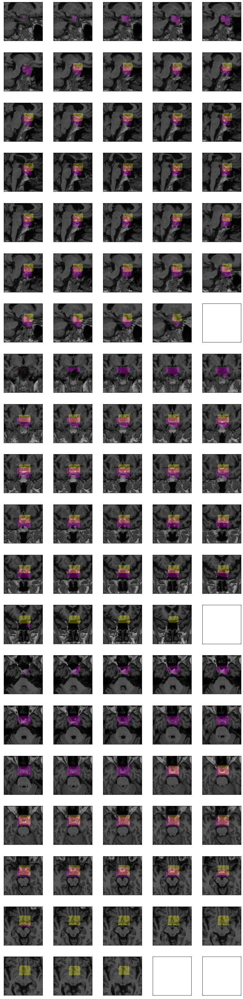

worst1
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.5855)
(52, 64, 39)
3 1
Pred: 
Bbox coords: (34, 49, 23) to (71, 71, 49). Size: 37, 22, 26.
Bounding box coord: from location (49, 23) of slice 34 to location (71, 49) of slice 71.
GT: 
Bbox coords: (33, 52, 27) to (71, 77, 51). Size: 38, 25, 24.
Bounding box coord: from location (52, 27) of slice 33 to location (77, 51) of slice 71.
Union: 
Bbox coords: (33, 49, 23) to (71, 77, 51). Size: 38, 28, 28.
Bounding box coord: from location (49, 23) of slice 33 to location (77, 51) of slice 71.
20 5


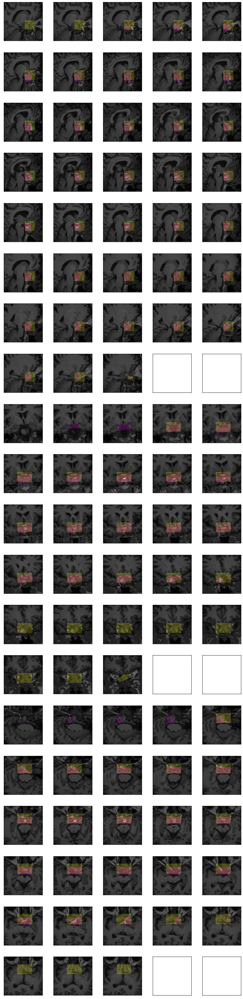

worst2
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.5860)
(44, 67, 49)
3 1
Pred: 
Bbox coords: (28, 48, 36) to (62, 73, 61). Size: 34, 25, 25.
Bounding box coord: from location (48, 36) of slice 28 to location (73, 61) of slice 62.
GT: 
Bbox coords: (27, 52, 35) to (62, 83, 63). Size: 35, 31, 28.
Bounding box coord: from location (52, 35) of slice 27 to location (83, 63) of slice 62.
Union: 
Bbox coords: (27, 48, 35) to (62, 83, 63). Size: 35, 35, 28.
Bounding box coord: from location (48, 35) of slice 27 to location (83, 63) of slice 62.
20 5


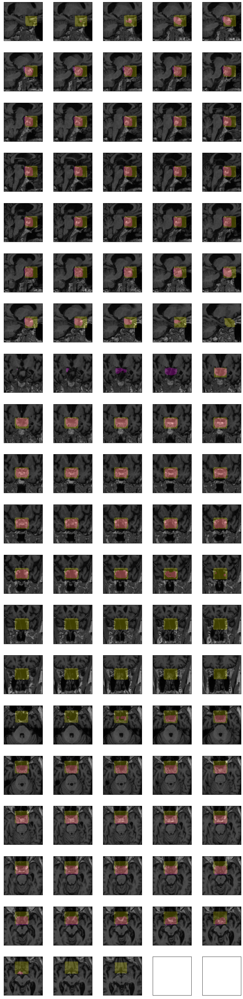

best0
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.9053)
(47, 60, 17)
3 1
Pred: 
Bbox coords: (30, 50, 4) to (64, 71, 29). Size: 34, 21, 25.
Bounding box coord: from location (50, 4) of slice 30 to location (71, 29) of slice 64.
GT: 
Bbox coords: (32, 50, 7) to (63, 70, 28). Size: 31, 20, 21.
Bounding box coord: from location (50, 7) of slice 32 to location (70, 28) of slice 63.
Union: 
Bbox coords: (30, 50, 4) to (64, 71, 29). Size: 34, 21, 25.
Bounding box coord: from location (50, 4) of slice 30 to location (71, 29) of slice 64.
17 5


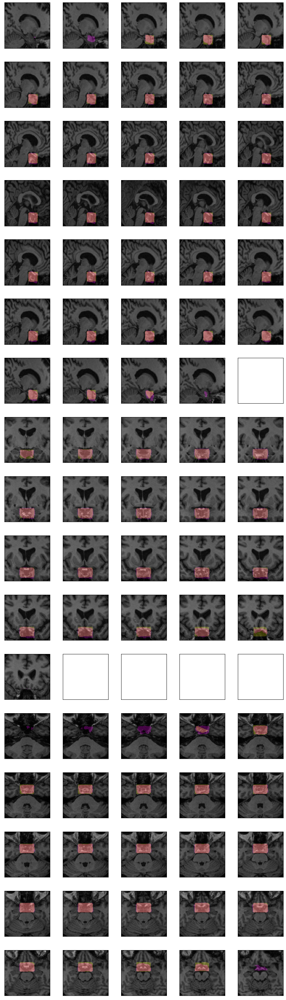

best1
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.9172)
(49, 49, 55)
3 1
Pred: 
Bbox coords: (30, 39, 44) to (68, 61, 66). Size: 38, 22, 22.
Bounding box coord: from location (39, 44) of slice 30 to location (61, 66) of slice 68.
GT: 
Bbox coords: (33, 40, 46) to (66, 59, 65). Size: 33, 19, 19.
Bounding box coord: from location (40, 46) of slice 33 to location (59, 65) of slice 66.
Union: 
Bbox coords: (30, 39, 44) to (68, 61, 66). Size: 38, 22, 22.
Bounding box coord: from location (39, 44) of slice 30 to location (61, 66) of slice 68.
18 5


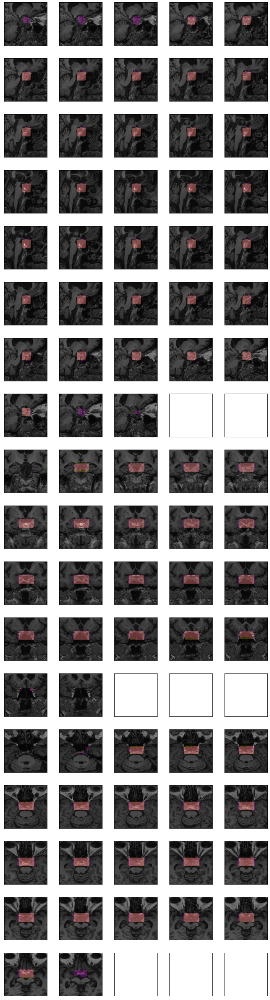

best2
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.9388)
(49, 45, 7)
3 1
Pred: 
Bbox coords: (33, 35, 0) to (66, 57, 15). Size: 33, 22, 15.
Bounding box coord: from location (35, 0) of slice 33 to location (57, 15) of slice 66.
GT: 
Bbox coords: (33, 35, 0) to (66, 56, 14). Size: 33, 21, 14.
Bounding box coord: from location (35, 0) of slice 33 to location (56, 14) of slice 66.
Union: 
Bbox coords: (33, 35, 0) to (66, 57, 15). Size: 33, 22, 15.
Bounding box coord: from location (35, 0) of slice 33 to location (57, 15) of slice 66.
15 5


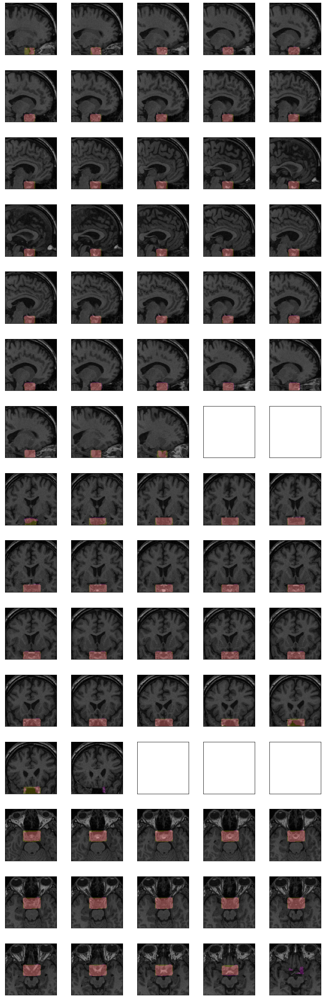

In [83]:
for i in range(6):
    name = ("worst0", "worst1", "worst2", "best0", "best1", "best2")[i]
    chosen_idx = (worst_idxs[0], worst_idxs[1], worst_idxs[2], best_idxs[0], best_idxs[1], best_idxs[2])[i] 
    batch_idx, within_batch_idx = idx2batch_idx(chosen_idx)
    print(name)
    # get ground truth
    mr, gt = all_data[batch_idx][within_batch_idx] 
    mr = mr.squeeze(0)
    gt = gt.squeeze(0).byte()
    print(mr.shape, gt.shape)
    # get ensemble
    ensemble_pred = ensemble_dice_majority_vote[chosen_idx]
    print(ensemble_pred.shape)
    # dice
    print(dice(ensemble_pred, gt))
    # mid idxs
    worst_mid_idxs = get_mid_idx(mask2bbox(np.asarray(gt)))
    print(worst_mid_idxs)
    # viz
    mr = np.asarray(mr)
    gt = np.asarray(gt)
    ensemble_pred = np.asarray(ensemble_pred)

    viz_axis(np_arr = mr, \
                bin_mask_arr   = gt,            color1 = "yellow",  alpha1=0.3, \
                bin_mask_arr2  = ensemble_pred, color2 = "magenta", alpha2=0.3, \
                slices=lrange(worst_mid_idxs[0],worst_mid_idxs[0]+1), fixed_axis=0, \
                axis_fn = np.rot90, \
                #title   = "Sag", \

                np_arr_b = mr, \
                bin_mask_arr_b   = gt,            color1_b = "yellow",  alpha1_b=0.3, \
                bin_mask_arr2_b  = ensemble_pred, color2_b = "magenta", alpha2_b=0.3, \
                slices_b = lrange(worst_mid_idxs[1],worst_mid_idxs[1]+1), fixed_axis_b=1, \
                #title_b  = "Cor", \

                np_arr_c = mr, \
                bin_mask_arr_c   = gt,            color1_c = "yellow",  alpha1_c=0.3, \
                bin_mask_arr2_c  = ensemble_pred, color2_c = "magenta", alpha2_c=0.3, \
                slices_c = lrange(worst_mid_idxs[2],worst_mid_idxs[2]+1), fixed_axis_c=2, \
                #title_c = "Axial", \

            grid = (3,1), hspace=0.0, wspace=0.0, fig_mult=2, save_src = f"error_analysis_{name}.png") 
    
    # viz all
    viz_compare_outputs(mr, gt, ensemble_pred)

ABIDE
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.8309)
(50, 66, 20)
3 1
Pred: 
Bbox coords: (33, 57, 8) to (67, 77, 32). Size: 34, 20, 24.
Bounding box coord: from location (57, 8) of slice 33 to location (77, 32) of slice 67.
GT: 
Bbox coords: (36, 59, 9) to (65, 74, 31). Size: 29, 15, 22.
Bounding box coord: from location (59, 9) of slice 36 to location (74, 31) of slice 65.
Union: 
Bbox coords: (33, 57, 8) to (67, 77, 32). Size: 34, 20, 24.
Bounding box coord: from location (57, 8) of slice 33 to location (77, 32) of slice 67.
16 5


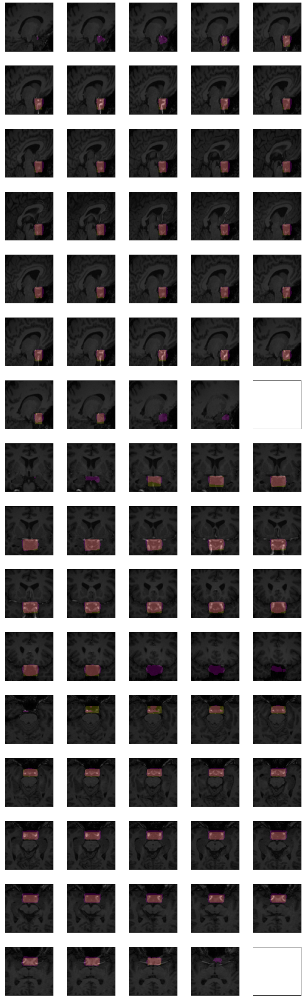

PPMI
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.8129)
(48, 55, 44)
3 1
Pred: 
Bbox coords: (30, 44, 31) to (67, 65, 55). Size: 37, 21, 24.
Bounding box coord: from location (44, 31) of slice 30 to location (65, 55) of slice 67.
GT: 
Bbox coords: (33, 46, 34) to (64, 64, 55). Size: 31, 18, 21.
Bounding box coord: from location (46, 34) of slice 33 to location (64, 55) of slice 64.
Union: 
Bbox coords: (30, 44, 31) to (67, 65, 55). Size: 37, 21, 24.
Bounding box coord: from location (44, 31) of slice 30 to location (65, 55) of slice 67.
18 5


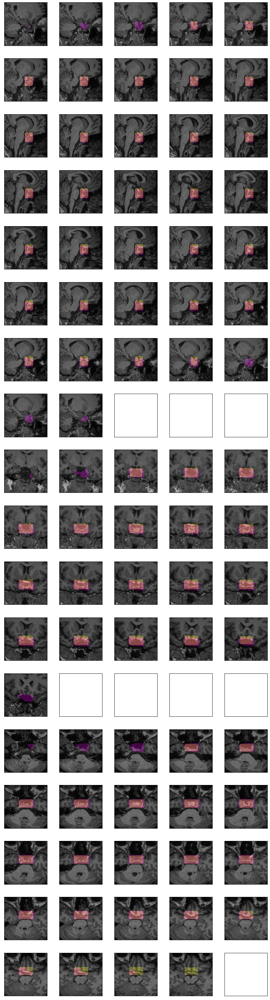

ICBM
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.8007)
(51, 57, 27)
3 1
Pred: 
Bbox coords: (31, 45, 13) to (72, 67, 36). Size: 41, 22, 23.
Bounding box coord: from location (45, 13) of slice 31 to location (67, 36) of slice 72.
GT: 
Bbox coords: (32, 48, 17) to (70, 67, 37). Size: 38, 19, 20.
Bounding box coord: from location (48, 17) of slice 32 to location (67, 37) of slice 70.
Union: 
Bbox coords: (31, 45, 13) to (72, 67, 37). Size: 41, 22, 24.
Bounding box coord: from location (45, 13) of slice 31 to location (67, 37) of slice 72.
19 5


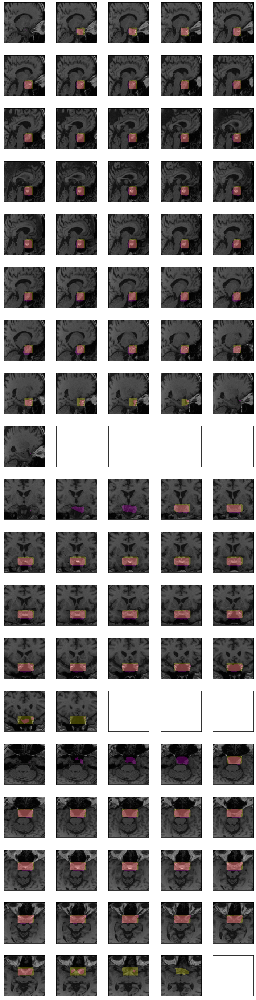

ADNI
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.6356)
(54, 69, 48)
3 1
Pred: 
Bbox coords: (37, 53, 25) to (70, 80, 56). Size: 33, 27, 31.
Bounding box coord: from location (53, 25) of slice 37 to location (80, 56) of slice 70.
GT: 
Bbox coords: (40, 57, 37) to (68, 81, 59). Size: 28, 24, 22.
Bounding box coord: from location (57, 37) of slice 40 to location (81, 59) of slice 68.
Union: 
Bbox coords: (37, 53, 25) to (70, 81, 59). Size: 33, 28, 34.
Bounding box coord: from location (53, 25) of slice 37 to location (81, 59) of slice 70.
20 5


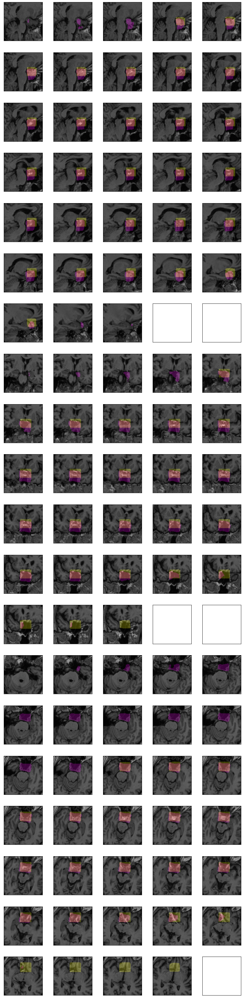

AIBL
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.8131)
(47, 74, 44)
3 1
Pred: 
Bbox coords: (32, 61, 29) to (63, 83, 56). Size: 31, 22, 27.
Bounding box coord: from location (61, 29) of slice 32 to location (83, 56) of slice 63.
GT: 
Bbox coords: (34, 62, 33) to (60, 86, 56). Size: 26, 24, 23.
Bounding box coord: from location (62, 33) of slice 34 to location (86, 56) of slice 60.
Union: 
Bbox coords: (32, 61, 29) to (63, 86, 56). Size: 31, 25, 27.
Bounding box coord: from location (61, 29) of slice 32 to location (86, 56) of slice 63.
18 5


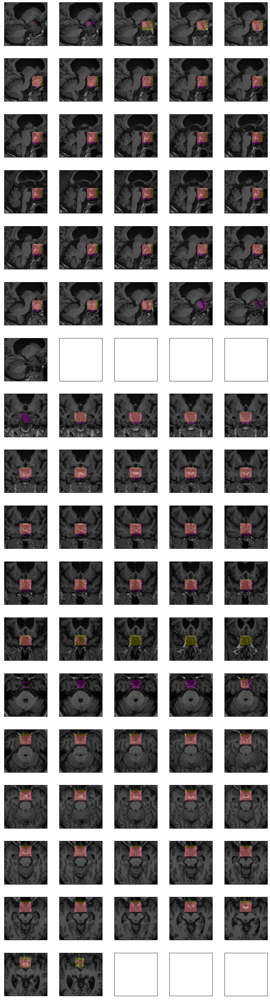

ABVIB
torch.Size([96, 96, 96]) torch.Size([96, 96, 96])
torch.Size([96, 96, 96])
tensor(0.8368)
(48, 62, 41)
3 1
Pred: 
Bbox coords: (27, 52, 24) to (68, 72, 54). Size: 41, 20, 30.
Bounding box coord: from location (52, 24) of slice 27 to location (72, 54) of slice 68.
GT: 
Bbox coords: (28, 53, 31) to (69, 71, 52). Size: 41, 18, 21.
Bounding box coord: from location (53, 31) of slice 28 to location (71, 52) of slice 69.
Union: 
Bbox coords: (27, 52, 24) to (69, 72, 54). Size: 42, 20, 30.
Bounding box coord: from location (52, 24) of slice 27 to location (72, 54) of slice 69.
19 5


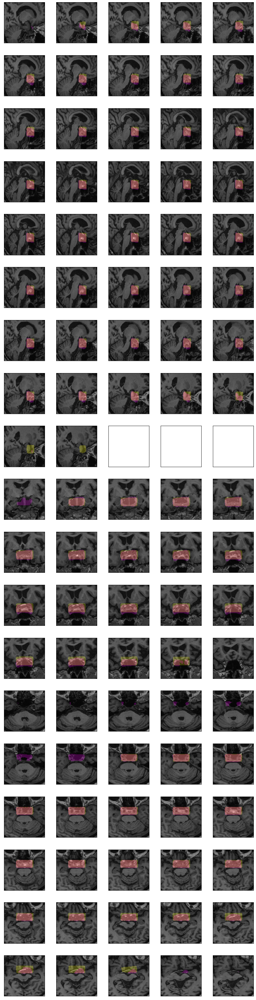

In [40]:
for i in range(6):
    name = ("ABIDE", "PPMI", "ICBM", "ADNI", "AIBL", "ABVIB")[i]
    chosen_idx = (random_abide_idx, random_ppmi_idx, random_icmb_idx, random_adni_idx, random_aibl_idx, random_abvib_idx)[i] 
    batch_idx, within_batch_idx = idx2batch_idx(chosen_idx)
    print(name)
    # get ground truth
    mr, gt = all_data[batch_idx][within_batch_idx] 
    mr = mr.squeeze(0)
    gt = gt.squeeze(0).byte()
    print(mr.shape, gt.shape)
    # get ensemble
    ensemble_pred = ensemble_dice_majority_vote[chosen_idx]
    print(ensemble_pred.shape)
    # dice
    print(dice(ensemble_pred, gt))
    # mid idxs
    worst_mid_idxs = get_mid_idx(mask2bbox(np.asarray(gt)))
    print(worst_mid_idxs)
    # viz
    mr = np.asarray(mr)
    gt = np.asarray(gt)
    ensemble_pred = np.asarray(ensemble_pred)

    viz_axis(np_arr = mr, \
                bin_mask_arr   = gt,            color1 = "yellow",  alpha1=0.3, \
                bin_mask_arr2  = ensemble_pred, color2 = "magenta", alpha2=0.3, \
                slices=lrange(worst_mid_idxs[0],worst_mid_idxs[0]+1), fixed_axis=0, \
                axis_fn = np.rot90, \
                #title   = "Sag", \

                np_arr_b = mr, \
                bin_mask_arr_b   = gt,            color1_b = "yellow",  alpha1_b=0.3, \
                bin_mask_arr2_b  = ensemble_pred, color2_b = "magenta", alpha2_b=0.3, \
                slices_b = lrange(worst_mid_idxs[1],worst_mid_idxs[1]+1), fixed_axis_b=1, \
                #title_b  = "Cor", \

                np_arr_c = mr, \
                bin_mask_arr_c   = gt,            color1_c = "yellow",  alpha1_c=0.3, \
                bin_mask_arr2_c  = ensemble_pred, color2_c = "magenta", alpha2_c=0.3, \
                slices_c = lrange(worst_mid_idxs[2],worst_mid_idxs[2]+1), fixed_axis_c=2, \
                #title_c = "Axial", \

            grid = (3,1), hspace=0.0, wspace=0.0, fig_mult=2, save_src = f"random_{name}.png") 
    
    # viz all
    viz_compare_outputs(mr, gt, ensemble_pred)

In [41]:
from helpers.losses import dice
print(dice(ensemble_pred, gt))

AttributeError: 'numpy.ndarray' object has no attribute 'contiguous'

In [42]:
worst_mid_idxs = get_mid_idx(mask2bbox(np.asarray(gt)))
print(worst_mid_idxs)

(48, 62, 41)


Pred: 
Bbox coords: (33, 57, 8) to (67, 77, 32). Size: 34, 20, 24.
Bounding box coord: from location (57, 8) of slice 33 to location (77, 32) of slice 67.
GT: 
Bbox coords: (36, 59, 9) to (65, 74, 31). Size: 29, 15, 22.
Bounding box coord: from location (59, 9) of slice 36 to location (74, 31) of slice 65.
Union: 
Bbox coords: (33, 57, 8) to (67, 77, 32). Size: 34, 20, 24.
Bounding box coord: from location (57, 8) of slice 33 to location (77, 32) of slice 67.
16 5


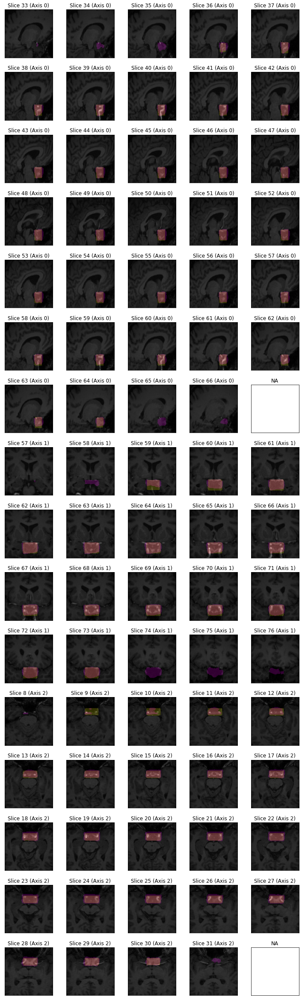

In [74]:
viz_compare_outputs(mr, gt, ensemble_pred)

In [77]:
mr = np.asarray(mr)
gt = np.asarray(gt)
ensemble_pred = np.asarray(ensemble_pred)

viz_axis(np_arr = mr, \
            bin_mask_arr   = gt,            color1 = "yellow",  alpha1=0.3, \
            bin_mask_arr2  = ensemble_pred, color2 = "magenta", alpha2=0.3, \
            slices=lrange(worst_mid_idxs[0],worst_mid_idxs[0]+1), fixed_axis=0, \
            axis_fn = np.rot90, \
            title   = "Sag", \

            np_arr_b = mr, \
            bin_mask_arr_b   = gt,            color1_b = "yellow",  alpha1_b=0.3, \
            bin_mask_arr2_b  = ensemble_pred, color2_b = "magenta", alpha2_b=0.3, \
            slices_b = lrange(worst_mid_idxs[1],worst_mid_idxs[1]+1), fixed_axis_b=1, \
            title_b  = "Cor", \

            np_arr_c = mr, \
            bin_mask_arr_c   = gt,            color1_c = "yellow",  alpha1_c=0.3, \
            bin_mask_arr2_c  = ensemble_pred, color2_c = "magenta", alpha2_c=0.3, \
            slices_c = lrange(worst_mid_idxs[2],worst_mid_idxs[2]+1), fixed_axis_c=2, \
            title_c = "Axial", \
  
        grid = (3,1), hspace=0.3, wspace=0.0, fig_mult=2, save_src = f"random_{name}.png") 

3 1


In [43]:
from helpers.preprocess import mask2bbox
from helpers.viz        import * # get_mid_idx

import matplotlib.pyplot as plt
%matplotlib inline

from matplotlib import colors
bin_cmap_yel  = colors.ListedColormap(['white', 'yellow'])
bin_cmap_blu  = colors.ListedColormap(['white', 'blue'])


import re
def get_folder_name(f): return re.search("\/([\d+]{5})\/", f).groups(0)[0]

def imshows(ims):
    nrow = len(ims)
    ncol = 9
    
    fig, axes = plt.subplots(nrow, ncol, figsize=(
        ncol * 3, nrow * 3), facecolor='white')
    for i, im_dict in enumerate(ims):
        im = im_dict["image"].detach().squeeze().cpu().numpy()
        label = im_dict["label"].detach().squeeze().cpu().numpy()
        pred  = im_dict["pred"].detach().squeeze().cpu().numpy()
        fname = im_dict["fname"]
        
        # get bbox
        bbox = mask2bbox(label)
        mids = get_mid_idx(bbox)
        for axis_idx in range(3):
            slice_idx = mids[axis_idx]

            # plot image label 0-2
            ax  = axes[i, 0+axis_idx]
            ax.set_title(f"{i}. Slice {slice_idx} (Axis {axis_idx})")
            ax.imshow(np.rot90(np.take(im, slice_idx, axis=axis_idx)), cmap=plt.cm.gray)
            ax.imshow(np.rot90(np.take(label, slice_idx, axis=axis_idx)), alpha=0.2, cmap=bin_cmap_yel)
            ax.axis("off")
            
            # plot image pred 3-5
            ax  = axes[i, 3+axis_idx]
            ax.set_title(f"Pred. Slice {slice_idx} (Axis {axis_idx})")
            ax.imshow(np.rot90(np.take(im, slice_idx, axis=axis_idx)), cmap=plt.cm.gray)
            ax.imshow(np.rot90(np.take(pred, slice_idx, axis=axis_idx)), alpha=0.2, cmap=bin_cmap_blu)
            ax.axis("off")
                
            # plot labels 6-8
            ax        = axes[i, 6+axis_idx]
            ax.axis("off")
            im_show = ax.imshow(np.rot90(np.take(label, slice_idx, axis=axis_idx)), cmap=bin_cmap_yel)
            im_show = ax.imshow(np.rot90(np.take(pred, slice_idx, axis=axis_idx)),  cmap=bin_cmap_blu, alpha=0.5)
            #fig.colorbar(im_show, ax=ax)
            
        # print fname
        axes[i,6].set_title(f"GT vs PRED")
        

In [44]:
print(bce_plot_keys), print(dice_plot_keys), print(simple_keys), print(models_to_ensemble)

['model_UNET3D_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627971506_Tue_Aug_03_2021_hr_02_min_18', 'model_VNET_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628677940_Wed_Aug_11_2021_hr_06_min_32', 'model_CONDSEG_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628302341_Fri_Aug_06_2021_hr_22_min_12']
['model_UNET3D_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628389599_Sat_Aug_07_2021_hr_22_min_26', 'model_VNET_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628463798_Sun_Aug_08_2021_hr_19_min_03', 'model_CONDSEG_loss_DICE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628658906_Wed_Aug_11_2021_hr_01_min_15']
['model_UNET3D_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1627971506_Tue_Aug_03_2021_hr_02_min_18', 'model_UN

(None, None, None, None)

,model_type,loss_type,dice_score
0,UNET3D,DICE_loss,0.891078
1,UNET3D,DICE_loss,0.836546
2,UNET3D,DICE_loss,0.887159
3,UNET3D,DICE_loss,0.721751
4,UNET3D,DICE_loss,0.756555


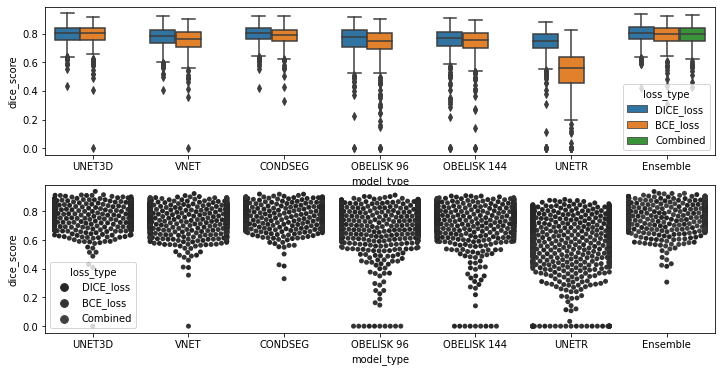

In [46]:
# Viz models to ensemble

metric = "dice" # false_pos

# if output doesn't intersect
undefined_val = {"false_pos": 0.0, "false_neg": 1.0}

simple_keys    = [k for k in models_to_ensemble_all] #[k for k in models_to_ensemble if "do_simple_True" in k]
bce_plot_keys  = [k for k in simple_keys if "BCE_loss" in k]
dice_plot_keys = [k for k in simple_keys if "DICE_loss" in k]

data = [{"model_type": rename2(fn), "loss_type":  "DICE_loss", f"{metric}_score":min(val,1)} 
        for i,fn in enumerate(dice_plot_keys) 
        for val in post_df_dict[fn][metric].values
       ] + \
    [{"model_type":  rename2(fn), "loss_type":  "BCE_loss", f"{metric}_score":min(val,1)} 
        for i,fn in enumerate(bce_plot_keys) 
        for val in post_df_dict[fn][metric].values
       ]

ensemble_data = []
ensemble_dfs   = (ensemble_bce_df, ensemble_dice_df, ensemble_all_df)
ensemble_types = ("BCE_loss", "DICE_loss", "Combined") 
for df, loss_type in zip(ensemble_dfs, ensemble_types):
    if len(df) > 0:
        ensemble_data += [{"model_type": "Ensemble",  "loss_type":  loss_type, f"{metric}_score":val} 
                          for val in df[metric].values]
    
together_data_df = pd.DataFrame(data+ensemble_data) 
data_df          = pd.DataFrame(data)
ensemble_df      = pd.DataFrame(ensemble_data)

display(data_df.head())

fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(12,6))
ax = sns.boxplot(x="model_type",   y=f"{metric}_score", data=together_data_df, hue="loss_type", ax=axes[0])
ax = sns.swarmplot(x="model_type", y=f"{metric}_score", data=together_data_df, hue="loss_type", color=".25", ax=axes[1])

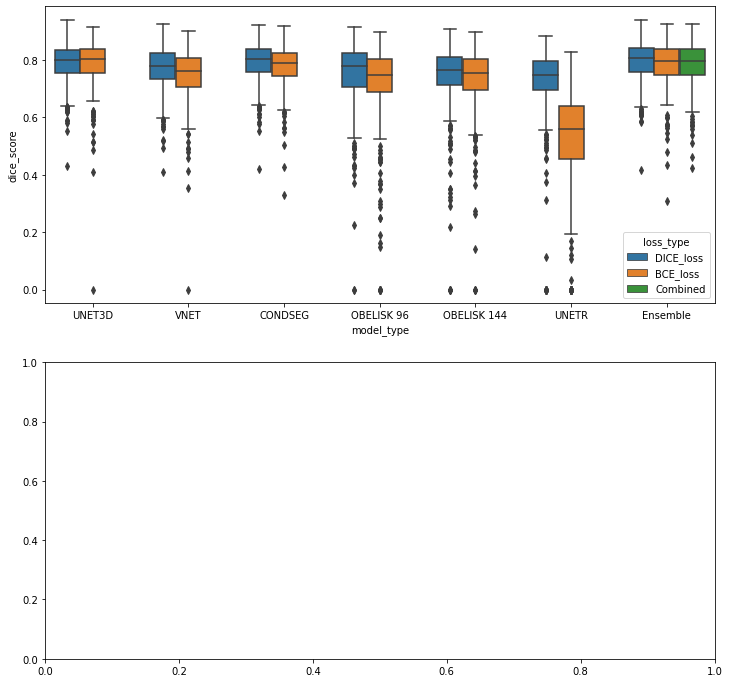

In [59]:
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(12,12))
ax = sns.boxplot(x="model_type",   y=f"{metric}_score", data=together_data_df, hue="loss_type", ax=axes[0])
#ax = sns.swarmplot(x="model_type", y=f"{metric}_score", data=together_data_df, hue="loss_type", ax=axes[1])

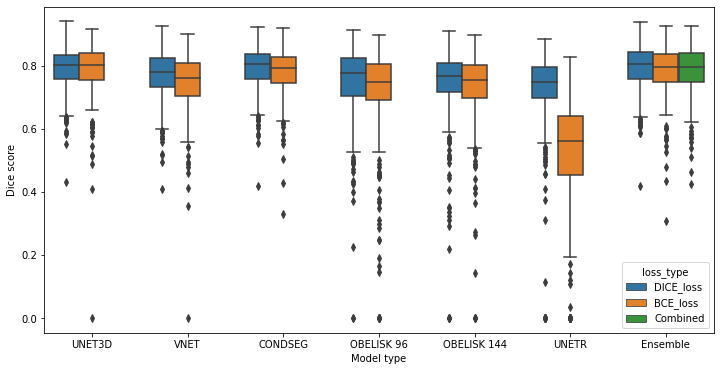

In [84]:
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(12,6))
ax = sns.boxplot(x="model_type",   y=f"{metric}_score", data=together_data_df, hue="loss_type", ax=axes)
ax.set_xlabel("Model type"); ax.set_ylabel("Dice score")

#ax = sns.swarmplot(x="model_type", y=f"{metric}_score", data=together_data_df, hue="loss_type", ax=axes[1])

#ax.set_title("Fig 2a. Model Performance on Test Set")
fig.savefig(f"fig_2a_three_ensemble.png", bbox_inches='tight', dpi = 1000)

In [61]:
ensemble_dice_swarm_data = [{"model_type": rename2(fn), "loss_type":  "DICE_loss", f"{metric}_score":min(val,1)} 
        for i,fn in enumerate(dice_plot_keys) 
        for val in post_df_dict[fn][metric].values
       ] + [{"model_type": "Ensemble",  "loss_type":  "DICE_loss", f"{metric}_score":val} 
                          for val in ensemble_dice_df[metric].values]

ensemble_bce_swarm_data = [{"model_type": rename2(fn), "loss_type":  "BCE_loss", f"{metric}_score":min(val,1)} 
        for i,fn in enumerate(bce_plot_keys) 
        for val in post_df_dict[fn][metric].values
       ] + [{"model_type": "Ensemble",  "loss_type":  "DICE_loss", f"{metric}_score":val} 
                          for val in ensemble_bce_df[metric].values]
# ensemble_types = ("BCE_loss", "DICE_loss", "Combined") 
# for df, loss_type in zip(ensemble_dfs, ensemble_types):
#     if len(df) > 0:
#         ensemble_data += [{"model_type": "ensemble",  "loss_type":  loss_type, f"{metric}_score":val} 
#                           for val in df[metric].values]

ensemble_dice_swarm_df = pd.DataFrame(ensemble_dice_swarm_data)
ensemble_bce_swarm_df  = pd.DataFrame(ensemble_bce_swarm_data)

Text(0.5, 1.0, 'gs[-1, -2]')

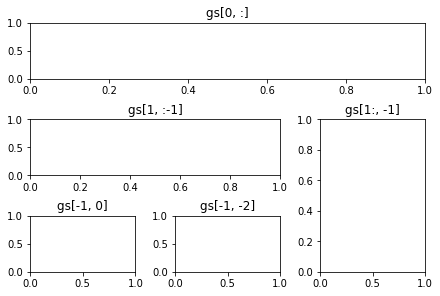

In [62]:
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

fig = plt.figure(constrained_layout=True)
gs = fig.add_gridspec(3, 3)
ax1 = fig.add_subplot(gs[0, :])
ax1.set_title('gs[0, :]')
ax2 = fig.add_subplot(gs[1, :-1])
ax2.set_title('gs[1, :-1]')
ax3 = fig.add_subplot(gs[1:, -1])
ax3.set_title('gs[1:, -1]')
ax4 = fig.add_subplot(gs[-1, 0])
ax4.set_title('gs[-1, 0]')
ax5 = fig.add_subplot(gs[-1, -2])
ax5.set_title('gs[-1, -2]')

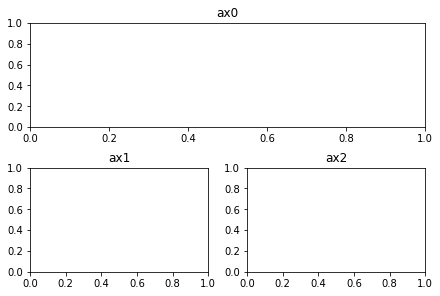

In [63]:
fig = plt.figure(constrained_layout=True)
gs = fig.add_gridspec(4, 4)
ax0 = fig.add_subplot(gs[:2, :])
ax0.set_title('ax0')
ax1 = fig.add_subplot(gs[2:,:2])
ax1.set_title('ax1')
ax2 = fig.add_subplot(gs[2:,2:])
ax2.set_title('ax2')
axes = [ax0, ax1, ax2]

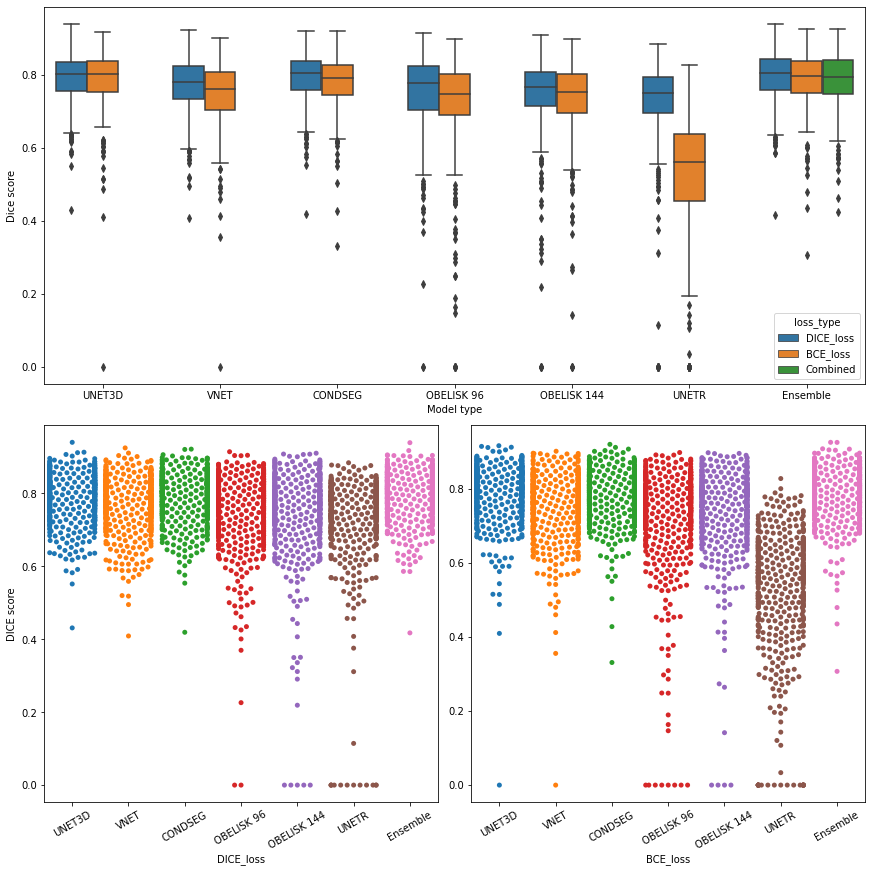

In [64]:
fig = plt.figure(constrained_layout=True, figsize=(12,12))
gs = fig.add_gridspec(4, 4)
ax0 = fig.add_subplot(gs[:2, :])
ax1 = fig.add_subplot(gs[2:,:2])
ax2 = fig.add_subplot(gs[2:,2:])
axes = [ax0, ax1, ax2]

ax0 = sns.boxplot(x="model_type",   y=f"{metric}_score", data=together_data_df, hue="loss_type", ax=axes[0])
ax1 = sns.swarmplot(x="model_type", y=f"{metric}_score", data=ensemble_dice_swarm_df, ax=axes[1])
ax2 = sns.swarmplot(x="model_type", y=f"{metric}_score", data=ensemble_bce_swarm_df, ax=axes[2])

# relocate legend
# legend = axes[0].legend(bbox_to_anchor=(1.01, 1),
#            borderaxespad=0)

#ax.legend([line1, line2, line3], ['label1', 'label2', 'label3'])

axes[0].set_xlabel("Model type"); axes[1].set_xlabel("DICE_loss"); axes[2].set_xlabel("BCE_loss")
axes[0].set_ylabel("Dice score"); axes[1].set_ylabel("DICE score");  axes[2].set_ylabel("")
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation = 30)
axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation = 30)
#axes[0].xaxis.setVisible(False)
#axes[1].yaxis.setVisible(False)
#ax.set_title("Fig 2b. Dice Loss Performance on Test Set")
fig.savefig(f"revised_fig_2b_swarm_three_ensemble.png", bbox_inches='tight', dpi = 1000)

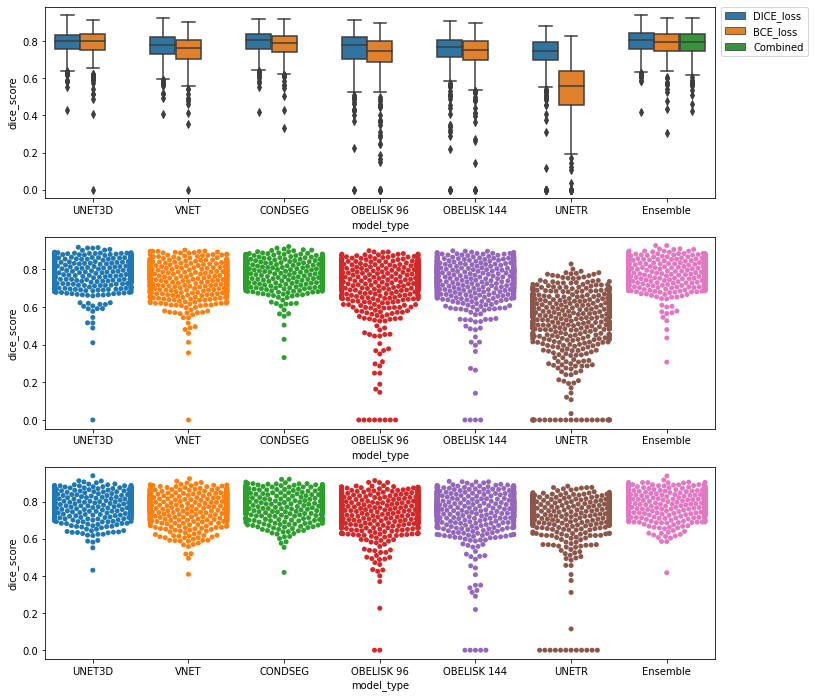

In [65]:
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(12,12))
ax = sns.boxplot(x="model_type",   y=f"{metric}_score", data=together_data_df, hue="loss_type", ax=axes[0])
ax = sns.swarmplot(x="model_type", y=f"{metric}_score", data=ensemble_dice_swarm_df, ax=axes[2])
ax = sns.swarmplot(x="model_type", y=f"{metric}_score", data=ensemble_bce_swarm_df, ax=axes[1])

# relocate legend
legend = axes[0].legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0)

In [39]:
axes[1].text("DICE_loss", bbox_to_anchor=(1.01, 1),
           borderaxespad=0)

TypeError: text() missing 2 required positional arguments: 'y' and 's'

In [35]:
legend.legendHandles

In [38]:
legend.texts

[Text(0, 0, 'DICE_loss'), Text(0, 0, 'BCE_loss'), Text(0, 0, 'Combined')]

In [37]:
legend??

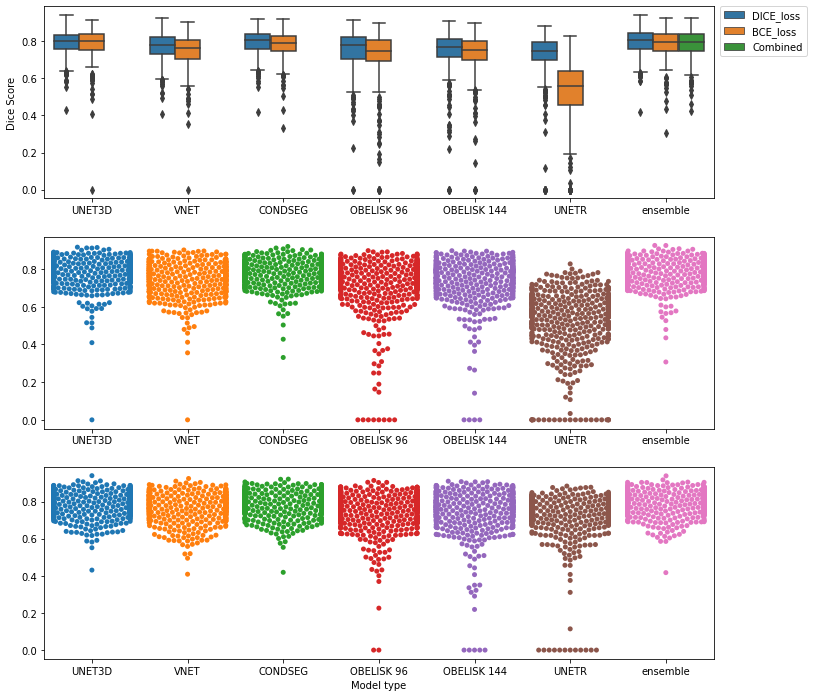

In [94]:
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(12,12))
ax = sns.boxplot(x="model_type",   y=f"{metric}_score", data=together_data_df, hue="loss_type", ax=axes[0])
ax = sns.swarmplot(x="model_type", y=f"{metric}_score", data=ensemble_dice_swarm_df, ax=axes[2])
ax = sns.swarmplot(x="model_type", y=f"{metric}_score", data=ensemble_bce_swarm_df, ax=axes[1])

# relocate legend
legend = axes[0].legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0)

#ax.legend([line1, line2, line3], ['label1', 'label2', 'label3'])

axes[0].set_xlabel(""); axes[1].set_xlabel(""); axes[2].set_xlabel("Model type")
axes[0].set_ylabel("Dice Score"); axes[1].set_ylabel("");  axes[2].set_ylabel("")
#axes[0].xaxis.setVisible(False)
#axes[1].yaxis.setVisible(False)
#ax.set_title("Fig 2b. Dice Loss Performance on Test Set")
fig.savefig(f"revised_fig_2b_swarm_three_ensemble.png", bbox_inches='tight', dpi = 1000)

In [117]:
ensemble_swarm_df[ensemble_swarm_df["model_type"]=="VNET"].head()

,model_type,loss_type,dice_score
484,VNET,DICE_loss,0.824466
485,VNET,DICE_loss,0.835408
486,VNET,DICE_loss,0.862108
487,VNET,DICE_loss,0.750748
488,VNET,DICE_loss,0.715014


In [118]:
post_df_dict[simple_keys[0]].head()

,dice,false_neg,false_pos,IoU,hausdorff_dist,image,label
0,0.885943,0.097021,0.130462,0.795240,3.741657,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50011/MP-RAGE/2000-01-01_00_00_00.0/S165075/ABIDE_50011_MRI_MP-RAGE_br_raw_20120830203207657_S165075_I329085_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50011/seg.nii
1,0.850229,0.118362,0.179020,0.739476,4.000000,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50373-50453/50379/MP-RAGE/2000-01-01_00_00_00.0/S165402/ABIDE_50379_MRI_MP-RAGE_br_raw_20120830233630136_S165402_I329412_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50373-50453/50379/seg.nii
2,0.888354,0.067848,0.151512,0.799135,4.242641,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50008/MP-RAGE/2000-01-01_00_00_00.0/S164971/ABIDE_50008_MRI_MP-RAGE_br_raw_20120830194128385_S164971_I328981_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50008/seg.nii
3,0.741018,0.310277,0.199445,0.588585,5.000000,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50313-50372/50333/MP-RAGE/2000-01-01_00_00_00.0/S165330/ABIDE_50333_MRI_MP-RAGE_br_raw_20120830225747452_S165330_I329340_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50313-50372/50333/seg.nii
4,0.742046,0.372111,0.093063,0.589884,8.944272,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50060/MP-RAGE/2000-01-01_00_00_00.0/S164445/ABIDE_50060_MRI_MP-RAGE_br_raw_20120830160721935_S164445_I328442_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/50002-50153/50060/seg.nii


In [119]:
post_df_dict[simple_keys[0]].columns

Index(['dice', 'false_neg', 'false_pos', 'IoU', 'hausdorff_dist', 'image',
       'label'],
      dtype='object')

In [35]:
vnet = 'model_VNET_loss_BCE_loss_full_res_96_pixdim_1.5_do_simple_True_do_flip_True_bs_2_epochs_60_time_1628677940_Wed_Aug_11_2021_hr_06_min_32'
pd.set_option('display.max_rows', None)
wdf = post_df_dict[vnet]
display(wdf[wdf["false_pos"]>1])

,dice,false_neg,false_pos,IoU,hausdorff_dist,image,label
186,0.0,1.0,1.797693e+308,0.0,NaN,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/ICMB/ICBM/UTHC_1091/MPRAGE_T1_AX_0.8_mm_TI-787/2008-11-19_12_51_58.0/S61555/las_corrected_n4.nii,/gpfs/data/oermannlab/private_data/DeepPit/PitMRdata/samir_labels/ICMB_full/UTHC_1091/seg.nii


In [38]:
math.isnan(wdf["hausdorff_dist"].values[186])

True

In [47]:
# model_types = np.unique(ensemble_swarm_df["model_type"].values)
# loss_types = np.unqiue(ensemble_swarm_df["loss_type"].values)

simple_keys    = [k for k in models_to_ensemble_all] #[k for k in models_to_ensemble if "do_simple_True" in k]
bce_plot_keys  = [k for k in simple_keys if "BCE_loss" in k]
dice_plot_keys = [k for k in simple_keys if "DICE_loss" in k]

def get_loss_type(fn):
    for x in ("BCE_loss", "DICE_loss"):
        if x in fn:
            return x
        
stats_data = []
metric_names = ['dice', 'false_neg', 'false_pos', 'IoU', 'hausdorff_dist']
for fn in simple_keys:
    metric_vals = [post_df_dict[fn][metric].values 
                   for metric in metric_names]
    metric_stats = {"model": rename2(fn), "loss": get_loss_type(fn)}
    for metric_name, vals in zip(metric_names, metric_vals):
        
        if metric_name == "hausdorff_dist":
            # exclude NaNs
            vals = np.asarray([v for v in vals if not math.isnan(v)])
            
        # SITK has inf for false_pos when prediction has no positives at all -- which is 0% false positive
        if metric_name == "false_pos":
            for check_idx,v in enumerate(vals):
                if v > 1.0:
                    print(rename2(fn), get_loss_type(fn), metric_name, "check idx", check_idx, v)
                    
            vals = np.array([v if v <= 1.0 else 0.0 for v in vals])
            
            
        #print(rename2(fn), get_loss_type(fn), metric_name, vals.std())
        metric_stats[metric_name] = f"{vals.mean():0.4f} ± {vals.std():0.3f}" 

    stats_data.append(metric_stats)
    
ensemble_dfs   = (ensemble_bce_df, ensemble_dice_df, ensemble_all_df)
ensemble_types = ("BCE_loss", "DICE_loss", "Combined") 
for df, loss_type in zip(ensemble_dfs, ensemble_types):
    if len(df) > 0:
        metric_vals = [df[metric].values 
                   for metric in metric_names]
        metric_stats = {"model": "Ensemble", "loss": loss_type}
        for metric_name, vals in zip(metric_names, metric_vals):
            
            if metric_name == "hausdorff_dist":
                # exclude NaNs
                vals = np.asarray([v for v in vals if not math.isnan(v)])
            
            # SITK has inf for false_pos when prediction has no positives at all -- which is 0% false positive
            if metric_name == "false_pos":
                for check_idx,v in enumerate(vals):
                    if v > 1.0:
                        print(rename2(fn), get_loss_type(fn), metric_name, "check idx", check_idx, v)

                vals = np.array([v if v <= 1.0 else 0.0 for v in vals])
            #print(rename2(fn), get_loss_type(fn), metric_name, vals.std())
            metric_stats[metric_name] = f"{vals.mean():0.4f} ± {vals.std():0.3f}" 

        stats_data.append(metric_stats)

VNET BCE_loss false_pos check idx 186 1.7976931348623157e+308
OBELISK 96 BCE_loss false_pos check idx 186 1.7976931348623157e+308
OBELISK 96 BCE_loss false_pos check idx 198 1.7976931348623157e+308
OBELISK 96 BCE_loss false_pos check idx 221 1.7976931348623157e+308
OBELISK 96 BCE_loss false_pos check idx 233 1.7976931348623157e+308
OBELISK 96 BCE_loss false_pos check idx 235 1.7976931348623157e+308
OBELISK 96 BCE_loss false_pos check idx 251 1.7976931348623157e+308
OBELISK 96 BCE_loss false_pos check idx 265 1.7976931348623157e+308
OBELISK 96 BCE_loss false_pos check idx 388 1.7976931348623157e+308
OBELISK 96 DICE_loss false_pos check idx 233 1.7976931348623157e+308
OBELISK 96 DICE_loss false_pos check idx 251 1.7976931348623157e+308
OBELISK 144 BCE_loss false_pos check idx 221 1.7976931348623157e+308
OBELISK 144 BCE_loss false_pos check idx 233 1.7976931348623157e+308
OBELISK 144 BCE_loss false_pos check idx 235 1.7976931348623157e+308
OBELISK 144 BCE_loss false_pos check idx 251 1.79

In [48]:
pd.DataFrame(stats_data)

,model,loss,dice,false_neg,false_pos,IoU,hausdorff_dist
0,UNET3D,BCE_loss,0.7881 ± 0.078,0.2657 ± 0.125,0.1250 ± 0.094,0.6563 ± 0.094,6.7082 ± 3.053
1,UNET3D,DICE_loss,0.7910 ± 0.065,0.2515 ± 0.116,0.1378 ± 0.091,0.6589 ± 0.085,6.6411 ± 2.201
2,VNET,BCE_loss,0.7489 ± 0.089,0.3431 ± 0.131,0.0955 ± 0.082,0.6060 ± 0.105,7.3075 ± 2.364
3,VNET,DICE_loss,0.7706 ± 0.074,0.2725 ± 0.127,0.1538 ± 0.096,0.6324 ± 0.094,7.0766 ± 2.464
4,CONDSEG,BCE_loss,0.7813 ± 0.068,0.2604 ± 0.117,0.1482 ± 0.094,0.6459 ± 0.087,6.7998 ± 2.067
5,CONDSEG,DICE_loss,0.7928 ± 0.065,0.2391 ± 0.119,0.1491 ± 0.093,0.6613 ± 0.085,6.5954 ± 2.335
6,OBELISK 96,BCE_loss,0.7172 ± 0.147,0.3511 ± 0.183,0.1307 ± 0.097,0.5755 ± 0.146,8.1439 ± 3.005
7,OBELISK 96,DICE_loss,0.7519 ± 0.106,0.3147 ± 0.154,0.1252 ± 0.088,0.6124 ± 0.119,7.3360 ± 2.542
8,OBELISK 144,BCE_loss,0.7359 ± 0.117,0.3385 ± 0.154,0.1258 ± 0.093,0.5934 ± 0.124,9.2224 ± 3.496
9,OBELISK 144,DICE_loss,0.7445 ± 0.124,0.3010 ± 0.166,0.1559 ± 0.103,0.6056 ± 0.130,8.2861 ± 3.185


In [49]:
print(pd.DataFrame(stats_data).to_latex(index=False))

\begin{tabular}{lllllll}
\toprule
       model &       loss &            dice &       false\_neg &       false\_pos &             IoU &   hausdorff\_dist \\
\midrule
      UNET3D &   BCE\_loss &  0.7881 ± 0.078 &  0.2657 ± 0.125 &  0.1250 ± 0.094 &  0.6563 ± 0.094 &   6.7082 ± 3.053 \\
      UNET3D &  DICE\_loss &  0.7910 ± 0.065 &  0.2515 ± 0.116 &  0.1378 ± 0.091 &  0.6589 ± 0.085 &   6.6411 ± 2.201 \\
        VNET &   BCE\_loss &  0.7489 ± 0.089 &  0.3431 ± 0.131 &  0.0955 ± 0.082 &  0.6060 ± 0.105 &   7.3075 ± 2.364 \\
        VNET &  DICE\_loss &  0.7706 ± 0.074 &  0.2725 ± 0.127 &  0.1538 ± 0.096 &  0.6324 ± 0.094 &   7.0766 ± 2.464 \\
     CONDSEG &   BCE\_loss &  0.7813 ± 0.068 &  0.2604 ± 0.117 &  0.1482 ± 0.094 &  0.6459 ± 0.087 &   6.7998 ± 2.067 \\
     CONDSEG &  DICE\_loss &  0.7928 ± 0.065 &  0.2391 ± 0.119 &  0.1491 ± 0.093 &  0.6613 ± 0.085 &   6.5954 ± 2.335 \\
  OBELISK 96 &   BCE\_loss &  0.7172 ± 0.147 &  0.3511 ± 0.183 &  0.1307 ± 0.097 &  0.5755 ± 0.146 &   8.143

In [ ]:
pd.DataFrame(stats_data[:-1]).pivot(index='model', columns='loss').reindex(["UNET3D", "VNET", "CONDSEG", "OBELISK 96", "OBELISK 144", "UNETR", "Ensemble"])

In [ ]:
combined_ensemble = stats_data[-1]
combined_ensemble["model"] = 'Ensemble (BCE + DICE)'
combined_ensemble = {k:v for k,v in combined_ensemble.items() if k!="loss"}
print(combined_ensemble)

In [ ]:
stats_data[0]

In [ ]:
pd.DataFrame(stats_data)

In [ ]:
print(pd.DataFrame(stats_data[:-1]).pivot(index='model', columns='loss').to_latex())

In [ ]:

"median_dice":np.median(np_indiv_dices),
"mean_dice":np_indiv_dices.mean(),
"std_dice":np_indiv_dices.std()

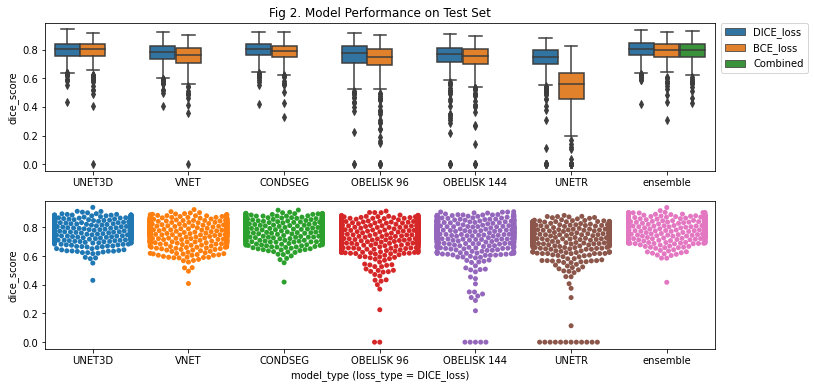

In [122]:
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(12,6))

ax = sns.boxplot(x="model_type",   y=f"{metric}_score", data=together_data_df, hue="loss_type", ax=axes[0])
ax = sns.swarmplot(x="model_type", y=f"{metric}_score", data=ensemble_swarm_df, ax=axes[1])

# relocate legend
axes[0].legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0)

#ax.tick_params(axis='both', which='major', labelsize=10, labelbottom = False, bottom=False, top = False, labeltop=False)
axes[0].set_title("Fig 2. Model Performance on Test Set")
axes[0].set(xlabel=None)
axes[1].set(xlabel="model_type (loss_type = DICE_loss)")
#axes[1].xaxis.tick_top() 
fig.savefig(f"fig_2_three_ensemble.png", bbox_inches='tight', dpi = 1000)

# https://stackoverflow.com/questions/58476654/how-to-remove-or-hide-x-axis-labels-from-a-seaborn-matplotlib-plot
# https://stackoverflow.com/questions/51759859/how-to-move-labels-from-bottom-to-top-without-adding-ticks

In [27]:
dsets_src    = f"{data_src}/PitMRdata"

# key,val = dset_name, path to top level dir
dset_dict = {
    "ABIDE"                  : f"{dsets_src}/ABIDE",
    "ABVIB"                  : f"{dsets_src}/ABVIB/ABVIB",
    "ADNI1_Complete_1Yr_1.5T": f"{dsets_src}/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI",
    "AIBL"                   : f"{dsets_src}/AIBL/AIBL",
    "ICMB"                   : f"{dsets_src}/ICMB/ICBM",
    "PPMI"                   : f"{dsets_src}/PPMI/PPMI",
}

ppmi  = [i for i in cross_lbl_items if dset_dict["PPMI"] in i[0]]
icmb = [i for i in cross_lbl_items if "ICMB" in i[1]]
adni = [i for i in cross_lbl_items if "ADNI1_full" in i[1]]
aibl = [i for i in cross_lbl_items if "AIBL" in i[1]]
abvib = [i for i in cross_lbl_items if "ABVIB" in i[1]]

ppmi  = [idx for idx,i in enumerate(cross_lbl_items) if dset_dict["PPMI"] in i[0]]
icmb = [idx for idx,i in enumerate(cross_lbl_items) if "ICMB" in i[1]]
adni = [idx for idx,i in enumerate(cross_lbl_items) if "ADNI1_full" in i[1]]
aibl = [idx for idx,i in enumerate(cross_lbl_items) if "AIBL" in i[1]]
abvib = [idx for idx,i in enumerate(cross_lbl_items) if "ABVIB" in i[1]]

#abide = [idx]
# print(len(ppmi))
# print(len(icmb))
# print(len(adni))
# print(len(aibl))
# print(len(abvib))
# print(len(test_items), len(valid_items), len(train_items))
print(len(cross_lbl_items))
print(len(ppmi)+len(icmb)+len(adni)+len(aibl)+len(abvib))
print(len(all_test_lbl_items))
print(len(cross_lbl_items)+len(test_items))

418
418
484
484


In [28]:
abide = [idx for idx,i in enumerate(all_test_lbl_items) if "ABIDE" in i[0]]
ppmi  = [idx for idx,i in enumerate(all_test_lbl_items) if dset_dict["PPMI"] in i[0]]
icmb = [idx for idx,i in enumerate(all_test_lbl_items) if "ICMB" in i[1]]
adni = [idx for idx,i in enumerate(all_test_lbl_items) if "ADNI1_full" in i[1]]
aibl = [idx for idx,i in enumerate(all_test_lbl_items) if "AIBL" in i[1]]
abvib = [idx for idx,i in enumerate(all_test_lbl_items) if "ABVIB" in i[1]]

print(len(ppmi)+len(icmb)+len(adni)+len(abide)+len(aibl)+len(abvib))

484


In [29]:
for dset_idxs, dset_name in zip((abide, ppmi, icmb, adni, aibl, abvib), 
                                ("abide", "ppmi", "icmb", "adni", "aibl", "abvib")):
    print(dset_name, len(dset_idxs))

abide 66
ppmi 95
icmb 52
adni 90
aibl 89
abvib 92


In [30]:
# assert no duplicates
for dset_idxs in (abide, ppmi, icmb, adni, aibl, abvib):
    assert(len(set(dset_idxs))==len(dset_idxs))

In [31]:
# assert images are listed in order in the post_df_dict
tkey = 'model_OBELISKHYBRID_loss_DICE_loss_full_res_144_pixdim_1.0_do_simple_True_do_flip_True_bs_2_epochs_60_time_1629303640_Wed_Aug_18_2021_hr_12_min_20'
assert np.array_equal(np.asarray([i[0] for i in all_test_lbl_items]),
                      np.asarray(post_df_dict[tkey]["image"].values))

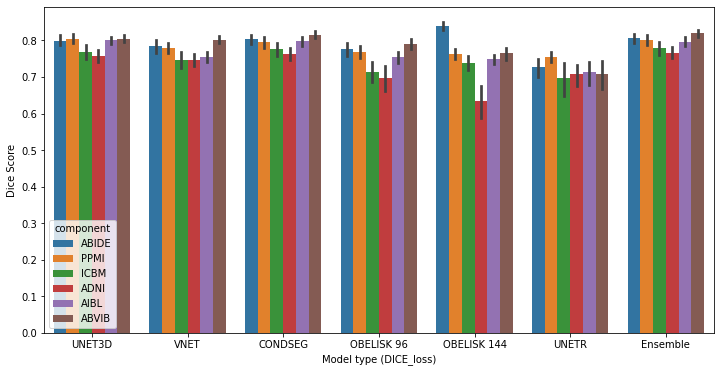

In [90]:
# bar chart

def get_component(val_idx):
    if val_idx in ppmi: return "PPMI"
    if val_idx in icmb: return "ICBM"
    if val_idx in adni: return "ADNI" # ADNI I
    if val_idx in aibl: return "AIBL"
    if val_idx in abvib: return "ABVIB"
    if val_idx in abide: return "ABIDE"
    print("whaa", val_idx)
    
component_data = [{"model_type": rename2(fn), "loss_type":  "DICE_loss", 
                   "component": get_component(val_idx), f"{metric}_score":min(val,1)} 
        for i,fn in enumerate(dice_plot_keys) 
        for val_idx, val in enumerate(post_df_dict[fn][metric].values)
       ] + [{"model_type": "Ensemble",  "loss_type":  "DICE_loss", 
             "component": get_component(val_idx), f"{metric}_score":val} 
                          for val_idx,val in enumerate(ensemble_dice_df[metric].values)]
# ensemble_types = ("BCE_loss", "DICE_loss", "Combined") 
# for df, loss_type in zip(ensemble_dfs, ensemble_types):
#     if len(df) > 0:
#         ensemble_data += [{"model_type": "ensemble",  "loss_type":  loss_type, f"{metric}_score":val} 
#                           for val in df[metric].values]

component_data_df = pd.DataFrame(component_data)

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(12,6))
ax = sns.barplot(x="model_type", y=f"{metric}_score", data=component_data_df, hue="component", ax=axes)
#ax.set_title("Fig 4. Performance Breakdown by Dataset")
ax.set(xlabel="Model type (DICE_loss)")
ax.set(ylabel="Dice Score")
fig.savefig(f"revised_fig_4_by_individual_test_set.png", bbox_inches='tight', dpi = 1000)

In [91]:
component_data_df

,model_type,loss_type,component,dice_score
0,UNET3D,DICE_loss,ABIDE,0.891078
1,UNET3D,DICE_loss,ABIDE,0.836546
2,UNET3D,DICE_loss,ABIDE,0.887159
3,UNET3D,DICE_loss,ABIDE,0.721751
4,UNET3D,DICE_loss,ABIDE,0.756555
...,...,...,...,...
3383,Ensemble,DICE_loss,ABVIB,0.732477
3384,Ensemble,DICE_loss,ABVIB,0.823207
3385,Ensemble,DICE_loss,ABVIB,0.846563
3386,Ensemble,DICE_loss,ABVIB,0.782376


In [50]:
# get component dset stats -- avg + std for Dice score
metric = "dice"

def get_component_vals(metric_vals):
    abide_vals  = [metric_vals[idx] for idx in abide]
    ppmi_vals   = [metric_vals[idx] for idx in ppmi]
    icmb_vals   = [metric_vals[idx] for idx in icmb]
    adni_vals   = [metric_vals[idx] for idx in adni]
    aibl_vals   = [metric_vals[idx] for idx in aibl]
    abvib_vals  = [metric_vals[idx] for idx in abvib]
    overall_vals = abide_vals + ppmi_vals + icmb_vals + adni_vals + aibl_vals + abvib_vals
    return abide_vals, ppmi_vals, icmb_vals, adni_vals, aibl_vals, abvib_vals, overall_vals

# model_types = np.unique(ensemble_swarm_df["model_type"].values)
# loss_types = np.unqiue(ensemble_swarm_df["loss_type"].values)

def get_loss_type(fn):
    for x in ("BCE_loss", "DICE_loss"):
        if x in fn:
            return x

numerical_component_stats_data = []
component_stats_data = []
for fn in simple_keys:
    metric_vals = post_df_dict[fn][metric].values 
    component_vals = get_component_vals(metric_vals)

    # define the row's model and loss
    metric_stats = {"model": rename2(fn), "loss": get_loss_type(fn)}
    numerical_metric_stats = {"model": rename2(fn), "loss": get_loss_type(fn)}
    # get stats per component dset
    for dset_vals, dset_name in zip(component_vals, ("ABIDE", "PPMI", "ICBM", "ADNI", "AIBL", "ABVIB", "Overall")):
        dset_vals = np.asarray(dset_vals)
        metric_stats[dset_name] = f"{dset_vals.mean():0.4f} ± {dset_vals.std():0.3f}"
        numerical_metric_stats[dset_name] = dset_vals.mean()
    component_stats_data.append(metric_stats)
    numerical_component_stats_data.append(numerical_metric_stats)
    
ensemble_dfs   = (ensemble_bce_df, ensemble_dice_df, ensemble_all_df)
ensemble_types = ("BCE_loss", "DICE_loss", "Combined") 
for df, loss_type in zip(ensemble_dfs, ensemble_types):
    if len(df) > 0:
        metric_vals = df[metric].values
        component_vals = get_component_vals(metric_vals)
        # define the row's model and loss
        metric_stats = {"model": "Ensemble", "loss": loss_type}
        numerical_metric_stats = {"model": rename2(fn), "loss": get_loss_type(fn)}
        # get stats per component dset
        for dset_vals, dset_name in zip(component_vals, ("ABIDE", "PPMI", "ICBM", "ADNI", "AIBL", "ABVIB", "Overall")):
            dset_vals = np.asarray(dset_vals)
            metric_stats[dset_name] = f"{dset_vals.mean():0.4f} ± {dset_vals.std():0.3f}"
            numerical_metric_stats[dset_name] = dset_vals.mean()
        component_stats_data.append(metric_stats)
        numerical_component_stats_data.append(numerical_metric_stats)

In [51]:
pd.DataFrame(component_stats_data)

,model,loss,ABIDE,PPMI,ICBM,ADNI,AIBL,ABVIB,Overall
0,UNET3D,BCE_loss,0.8030 ± 0.053,0.8018 ± 0.066,0.7356 ± 0.133,0.7630 ± 0.084,0.8000 ± 0.051,0.8060 ± 0.055,0.7881 ± 0.078
1,UNET3D,DICE_loss,0.7999 ± 0.054,0.8051 ± 0.062,0.7686 ± 0.075,0.7588 ± 0.079,0.8004 ± 0.051,0.8053 ± 0.049,0.7910 ± 0.065
2,VNET,BCE_loss,0.7616 ± 0.076,0.7601 ± 0.093,0.6865 ± 0.144,0.7483 ± 0.080,0.7319 ± 0.063,0.7806 ± 0.056,0.7489 ± 0.089
3,VNET,DICE_loss,0.7846 ± 0.073,0.7791 ± 0.074,0.7478 ± 0.083,0.7474 ± 0.080,0.7550 ± 0.067,0.8026 ± 0.050,0.7706 ± 0.074
4,CONDSEG,BCE_loss,0.8056 ± 0.053,0.7772 ± 0.072,0.7590 ± 0.089,0.7579 ± 0.073,0.7838 ± 0.053,0.8012 ± 0.054,0.7813 ± 0.068
5,CONDSEG,DICE_loss,0.8027 ± 0.051,0.7945 ± 0.067,0.7768 ± 0.068,0.7639 ± 0.079,0.7983 ± 0.059,0.8158 ± 0.045,0.7928 ± 0.065
6,OBELISK 96,BCE_loss,0.7844 ± 0.070,0.7458 ± 0.088,0.5919 ± 0.187,0.6742 ± 0.211,0.7119 ± 0.130,0.7574 ± 0.081,0.7172 ± 0.147
7,OBELISK 96,DICE_loss,0.7765 ± 0.072,0.7683 ± 0.085,0.7142 ± 0.099,0.6975 ± 0.167,0.7540 ± 0.070,0.7899 ± 0.064,0.7519 ± 0.106
8,OBELISK 144,BCE_loss,0.8165 ± 0.049,0.7645 ± 0.076,0.6901 ± 0.079,0.6501 ± 0.194,0.7407 ± 0.066,0.7536 ± 0.077,0.7359 ± 0.117
9,OBELISK 144,DICE_loss,0.8393 ± 0.043,0.7635 ± 0.067,0.7389 ± 0.070,0.6335 ± 0.206,0.7491 ± 0.062,0.7643 ± 0.085,0.7445 ± 0.124


In [52]:
pd.DataFrame(numerical_component_stats_data)

,model,loss,ABIDE,PPMI,ICBM,ADNI,AIBL,ABVIB,Overall
0,UNET3D,BCE_loss,0.802994,0.801773,0.735603,0.763012,0.800029,0.806002,0.788106
1,UNET3D,DICE_loss,0.799860,0.805145,0.768638,0.758800,0.800409,0.805308,0.791044
2,VNET,BCE_loss,0.761611,0.760066,0.686517,0.748348,0.731903,0.780550,0.748911
3,VNET,DICE_loss,0.784636,0.779054,0.747831,0.747370,0.754977,0.802603,0.770618
4,CONDSEG,BCE_loss,0.805552,0.777189,0.759005,0.757893,0.783830,0.801151,0.781291
5,CONDSEG,DICE_loss,0.802746,0.794539,0.776834,0.763947,0.798308,0.815796,0.792801
6,OBELISK 96,BCE_loss,0.784371,0.745848,0.591859,0.674183,0.711934,0.757378,0.717186
7,OBELISK 96,DICE_loss,0.776524,0.768302,0.714208,0.697518,0.753985,0.789932,0.751928
8,OBELISK 144,BCE_loss,0.816474,0.764489,0.690112,0.650108,0.740682,0.753553,0.735861
9,OBELISK 144,DICE_loss,0.839272,0.763490,0.738920,0.633524,0.749066,0.764329,0.744524


In [53]:
pd.DataFrame(numerical_component_stats_data)["ABIDE"]

0     0.802994
1     0.799860
2     0.761611
3     0.784636
4     0.805552
5     0.802746
6     0.784371
7     0.776524
8     0.816474
9     0.839272
10    0.556920
11    0.726895
12    0.802150
13    0.805444
14    0.800045
Name: ABIDE, dtype: float64

In [54]:
pd.DataFrame(component_stats_data)["AIBL"]

0     0.8000 ± 0.051
1     0.8004 ± 0.051
2     0.7319 ± 0.063
3     0.7550 ± 0.067
4     0.7838 ± 0.053
5     0.7983 ± 0.059
6     0.7119 ± 0.130
7     0.7540 ± 0.070
8     0.7407 ± 0.066
9     0.7491 ± 0.062
10    0.5528 ± 0.150
11    0.7127 ± 0.152
12    0.7856 ± 0.052
13    0.7963 ± 0.056
14    0.7842 ± 0.055
Name: AIBL, dtype: object

In [55]:
def get_data_max(col, num_df, do_print=False): 
    idx = num_df[col].idxmax()
    if do_print:
        print(num_df[col].values[idx])
        print(df[col].values[idx])
    return df[col].values[idx]

In [56]:
# Set df
df     = pd.DataFrame(component_stats_data)
num_df = pd.DataFrame(numerical_component_stats_data)

get_data_max("ICBM", num_df, do_print=True)

0.7780382814877835
0.7780 ± 0.066


'0.7780 ± 0.066'

In [57]:
# Sources -- auto bolding max value in column
# https://flopska.com/highlighting-pandas-to_latex-output-in-bold-face-for-extreme-values.html
# https://blog.martisak.se/2021/04/10/publication_ready_tables/

# Set df
df     = pd.DataFrame(component_stats_data)
num_df = pd.DataFrame(numerical_component_stats_data)
def bold_extreme_values(data, data_max):
    if data == data_max:
        return "\\bfseries %s" % data

    return data

 # Specify in which columns to make the maximum bold
col_show_max = ["ABIDE", "PPMI", "ICBM", "ADNI", "AIBL", "ABVIB", "Overall"]                        
# Iterate through columns
for k in col_show_max:
    df[k] = df[k].apply(
        lambda data: bold_extreme_values(data, data_max=get_data_max(k, num_df)))

In [58]:
df

,model,loss,ABIDE,PPMI,ICBM,ADNI,AIBL,ABVIB,Overall
0,UNET3D,BCE_loss,0.8030 ± 0.053,0.8018 ± 0.066,0.7356 ± 0.133,0.7630 ± 0.084,0.8000 ± 0.051,0.8060 ± 0.055,0.7881 ± 0.078
1,UNET3D,DICE_loss,0.7999 ± 0.054,\bfseries 0.8051 ± 0.062,0.7686 ± 0.075,0.7588 ± 0.079,\bfseries 0.8004 ± 0.051,0.8053 ± 0.049,0.7910 ± 0.065
2,VNET,BCE_loss,0.7616 ± 0.076,0.7601 ± 0.093,0.6865 ± 0.144,0.7483 ± 0.080,0.7319 ± 0.063,0.7806 ± 0.056,0.7489 ± 0.089
3,VNET,DICE_loss,0.7846 ± 0.073,0.7791 ± 0.074,0.7478 ± 0.083,0.7474 ± 0.080,0.7550 ± 0.067,0.8026 ± 0.050,0.7706 ± 0.074
4,CONDSEG,BCE_loss,0.8056 ± 0.053,0.7772 ± 0.072,0.7590 ± 0.089,0.7579 ± 0.073,0.7838 ± 0.053,0.8012 ± 0.054,0.7813 ± 0.068
5,CONDSEG,DICE_loss,0.8027 ± 0.051,0.7945 ± 0.067,0.7768 ± 0.068,0.7639 ± 0.079,0.7983 ± 0.059,0.8158 ± 0.045,0.7928 ± 0.065
6,OBELISK 96,BCE_loss,0.7844 ± 0.070,0.7458 ± 0.088,0.5919 ± 0.187,0.6742 ± 0.211,0.7119 ± 0.130,0.7574 ± 0.081,0.7172 ± 0.147
7,OBELISK 96,DICE_loss,0.7765 ± 0.072,0.7683 ± 0.085,0.7142 ± 0.099,0.6975 ± 0.167,0.7540 ± 0.070,0.7899 ± 0.064,0.7519 ± 0.106
8,OBELISK 144,BCE_loss,0.8165 ± 0.049,0.7645 ± 0.076,0.6901 ± 0.079,0.6501 ± 0.194,0.7407 ± 0.066,0.7536 ± 0.077,0.7359 ± 0.117
9,OBELISK 144,DICE_loss,\bfseries 0.8393 ± 0.043,0.7635 ± 0.067,0.7389 ± 0.070,0.6335 ± 0.206,0.7491 ± 0.062,0.7643 ± 0.085,0.7445 ± 0.124


In [59]:
print(df.to_latex(index=False))

\begin{tabular}{lllllllll}
\toprule
       model &       loss &                     ABIDE &                      PPMI &                      ICBM &                      ADNI &                      AIBL &                     ABVIB &                   Overall \\
\midrule
      UNET3D &   BCE\_loss &            0.8030 ± 0.053 &            0.8018 ± 0.066 &            0.7356 ± 0.133 &            0.7630 ± 0.084 &            0.8000 ± 0.051 &            0.8060 ± 0.055 &            0.7881 ± 0.078 \\
      UNET3D &  DICE\_loss &            0.7999 ± 0.054 &  \textbackslash bfseries 0.8051 ± 0.062 &            0.7686 ± 0.075 &            0.7588 ± 0.079 &  \textbackslash bfseries 0.8004 ± 0.051 &            0.8053 ± 0.049 &            0.7910 ± 0.065 \\
        VNET &   BCE\_loss &            0.7616 ± 0.076 &            0.7601 ± 0.093 &            0.6865 ± 0.144 &            0.7483 ± 0.080 &            0.7319 ± 0.063 &            0.7806 ± 0.056 &            0.7489 ± 0.089 \\
        VNET &  DICE\_lo

In [60]:
s = df.to_latex(index=False)
print(s)

\begin{tabular}{lllllllll}
\toprule
       model &       loss &                     ABIDE &                      PPMI &                      ICBM &                      ADNI &                      AIBL &                     ABVIB &                   Overall \\
\midrule
      UNET3D &   BCE\_loss &            0.8030 ± 0.053 &            0.8018 ± 0.066 &            0.7356 ± 0.133 &            0.7630 ± 0.084 &            0.8000 ± 0.051 &            0.8060 ± 0.055 &            0.7881 ± 0.078 \\
      UNET3D &  DICE\_loss &            0.7999 ± 0.054 &  \textbackslash bfseries 0.8051 ± 0.062 &            0.7686 ± 0.075 &            0.7588 ± 0.079 &  \textbackslash bfseries 0.8004 ± 0.051 &            0.8053 ± 0.049 &            0.7910 ± 0.065 \\
        VNET &   BCE\_loss &            0.7616 ± 0.076 &            0.7601 ± 0.093 &            0.6865 ± 0.144 &            0.7483 ± 0.080 &            0.7319 ± 0.063 &            0.7806 ± 0.056 &            0.7489 ± 0.089 \\
        VNET &  DICE\_lo

In [65]:
def finangle_latex(s):
    # remove double repeat
    for model_name in ("UNET3D", "VNET", "CONDSEG", "UNETR", "OBELISK 96", "OBELISK 144", "Ensemble"):
        second_idx = s.rindex(model_name)
        s = s[:second_idx] + s[second_idx+len(model_name):]
        
        if model_name == "Ensemble":
            # do it again
            second_idx = s.rindex(model_name)
            s = s[:second_idx] + s[second_idx+len(model_name):]
            
    # add hline
    
    #
    return s

In [66]:
print(finangle_latex(s))

\begin{tabular}{lllllllll}
\toprule
       model &       loss &                     ABIDE &                      PPMI &                      ICBM &                      ADNI &                      AIBL &                     ABVIB &                   Overall \\
\midrule
      UNET3D &   BCE\_loss &            0.8030 ± 0.053 &            0.8018 ± 0.066 &            0.7356 ± 0.133 &            0.7630 ± 0.084 &            0.8000 ± 0.051 &            0.8060 ± 0.055 &            0.7881 ± 0.078 \\
       &  DICE\_loss &            0.7999 ± 0.054 &  \textbackslash bfseries 0.8051 ± 0.062 &            0.7686 ± 0.075 &            0.7588 ± 0.079 &  \textbackslash bfseries 0.8004 ± 0.051 &            0.8053 ± 0.049 &            0.7910 ± 0.065 \\
        VNET &   BCE\_loss &            0.7616 ± 0.076 &            0.7601 ± 0.093 &            0.6865 ± 0.144 &            0.7483 ± 0.080 &            0.7319 ± 0.063 &            0.7806 ± 0.056 &            0.7489 ± 0.089 \\
         &  DICE\_loss &      

In [ ]:
#ax = sns.swarmplot(x="model_type", y=f"{metric}_score", data=together_data_df, hue="loss_type", ax=axes[1])


In [ ]:
n_worst = 5
dices = ensemble_all_df[f"{metric}"].values
worst_idxs = sorted(range(len(dices)), key=lambda x: dices[x])[:n_worst]
worst_dices = [dices[x] for x in worst_idxs]
worst_ensemble_idxs = {"idxs": worst_idxs, "dices": worst_dices}

print(f"Worst ensemble idxs")
print(worst_ensemble_idxs)

In [ ]:
# wrost
items = all_test_lbl_items #ppmi, icmb, adni, aibl, abvib, test_items
itemsd = getd(items)

# get dices, worst indexes
worst_index_dict = {}

for done_fn in models_to_ensemble:
    model_name = Path(done_fn).name
    check_post_df = post_df_dict[model_name]
    
    # sort 5 worst idxs + DICE
    n_worst = 5
    dices = check_post_df[f"{metric}"].values
    worst_idxs = sorted(range(len(dices)), key=lambda x: dices[x])[:n_worst]
    worst_dices = [dices[x] for x in worst_idxs]
    worst_index_dict[model_name] = {"idxs": worst_idxs, "dices": worst_dices}
    
    if len(check_post_df) != len(itemsd):
        print(done_fn)
        print("Len", len(check_post_df))
        print("*" * 50)
        
print(worst_index_dict); print("*"*50)
for model_fn in models_to_ensemble:
    print(model_fn)
    print(worst_index_dict[model_fn]["idxs"])
    print(worst_index_dict[model_fn]["dices"])
    print("*"*50)

In [ ]:
for done_fn in models_to_ensemble:
    model_name = Path(done_fn).name
    check_post_df = post_df_dict[model_name]
    
    # sort 5 worst idxs + DICE
    dices = check_post_df[f"{metric}"].values
    ensemble_component_dices = [dices[i] for i in worst_ensemble_idxs["idxs"]]
   
    print(model_name)
    print(ensemble_component_dices)
    print(worst_ensemble_idxs["idxs"])
    print(worst_ensemble_idxs["dices"])
    print("*"*50)

In [ ]:
# load indiv predictions
def idx2batch_idx(idx):
    for batch_idx_,range_ in enumerate(ranges):
        if idx in range_:
            batch_idx = batch_idx_
            within_batch_idx = idx - range_[0]
            return batch_idx, within_batch_idx
        
def load_model_preds(model_fn, idxs):
    preds = []
    model_name = Path(model_fn).name
    for idx in idxs:
        batch_idx, within_batch_idx = idx2batch_idx(idx)
        with open(f"{run_src}/{model_name}/preds_batch_{batch_idx}_bs_{bs}.pkl", 'rb') as handle:
                preds.append(pickle.load(handle)[within_batch_idx])
    return preds


# create batches
bs        = 5
batches = [itemsd[i:min(i+bs, len(itemsd))] for i in range(0,len(itemsd),bs)]
ranges = [range(i,min(i+bs, len(itemsd))) for i in range(0,len(itemsd),bs)]

start = time.time()
model_preds_dict = {model_fn: load_model_preds(model_fn, worst_ensemble_idxs["idxs"])
                    for model_fn in models_to_ensemble
                   }
elapsed = time.time() - start
print(f"Elapsed: {elapsed:0.2f} s.")

In [ ]:
model_fn = models_to_ensemble[0]
print(len(worst_ensemble_idxs["idxs"]))
print(model_fn)
print(len(model_preds_dict[model_fn]))

In [ ]:
#load labels
val_str = f"full_res_{full_res[0]}_pixdim_{pixdim[0]}_do_condseg_{do_condseg}"
transformed_labels_src = f"{data_src}/saved_transformed_labels/{val_str}"
all_data = []

start = time.time()
for i in range(len(batches)):
    with open(f"{transformed_labels_src}/transformed_labels_batch_{i}_bs_{bs}.pkl", 'rb') as handle:
        all_data += pickle.load(handle)
        
elapsed = time.time() - start
print(f"Load transformed inputs/labels. Elapsed: {elapsed:0.2f} s")


In [ ]:
worst_all_inputs = [all_data[i][0] for i in worst_ensemble_idxs["idxs"]]
worst_all_labels = [all_data[i][1].squeeze(0) for i in worst_ensemble_idxs["idxs"]]

In [ ]:
worst_all_ensemble = [ensemble_all_majority_vote[i] for i in worst_ensemble_idxs["idxs"]]
worst_all_preds = [model_preds_dict[model_fn] for model_fn in models_to_ensemble]

In [ ]:
# worst all labels = [label full_res x num idxs]; same for ensemble
# worst all preds = [for each model_fn: pred 2xfull_res]
print("labels: ", len(worst_all_labels), worst_all_labels[0].shape)
print("ensemble: ", len(worst_all_ensemble), worst_all_ensemble[0].shape)
print("ensemble component model preds: ", len(worst_all_preds), len(worst_all_preds[0]))
print("indiv ensemble component pred: ", worst_all_preds[0][0].shape)

In [ ]:
# viz 
from helpers.viz import get_mid_idx

idx = 0
input = worst_all_inputs[idx]
label = worst_all_labels[idx]
ensemble_mk = worst_all_ensemble[idx]
component_preds = [model_pred[idx] for model_pred in worst_all_preds]

gt_bbox       = batch_get_bbox(label.unsqueeze(0))[0]
ensemble_bbox = batch_get_bbox(ensemble_mk.unsqueeze(0))[0]
pred_bboxs    = [batch_get_bbox(model_pred.unsqueeze(0), preds=True)[0] for model_pred in component_preds]

print("gt", gt_bbox)
print("ensemble", ensemble_bbox)
for i,pred_bbox in enumerate(pred_bboxs):
    print(f"model {i}", pred_bbox)
    # models_to_ensemble[i],

In [ ]:
# for done_fn in models_to_ensemble:
#     model_name = Path(done_fn).name
#     check_post_df = post_df_dict[model_name]
    
#     # sort 5 worst idxs + DICE
#     dices = check_post_df[f"{metric}"].values
#     ensemble_component_dices = [dices[i] for i in worst_ensemble_idxs["idxs"]]
   
#     print(model_name)
#     print(ensemble_component_dices)
#     print(worst_ensemble_idxs["idxs"])
#     print(worst_ensemble_idxs["dices"])
#     print("*"*50)

In [ ]:
# https://stackoverflow.com/questions/237079/how-to-get-file-creation-modification-date-times-in-python
import os, time
def creation_date(file):
    """
    Try to get the date that a file was created, falling back to when it was
    last modified if that isn't possible.
    See http://stackoverflow.com/a/39501288/1709587 for explanation.
    """
    print("last modified: %s" % time.ctime(os.path.getmtime(file)))
    print("created: %s" % time.ctime(os.path.getctime(file)))

In [ ]:
creation_date(f"{run_src}/{models_to_ensemble[0]}/post_lcc_df.pkl")

In [ ]:
worst_index_dict

In [ ]:
from helpers.postprocess import get_largest_connected_component, eval_measure, eval_lcc

# create batches
bs        = 5
batches = [itemsd[i:min(i+bs, len(itemsd))] for i in range(0,len(itemsd),bs)]

In [ ]:
model_preds_dict = {}
def load_model_preds(model_fn):
    preds = []
    model_name = Path(model_fn).name
    for i in range(len(batches)):
        with open(f"{run_src}/{model_name}/preds_batch_{i}_bs_{bs}.pkl", 'rb') as handle:
            preds += pickle.load(handle)
    model_preds_dict[model_fn] = preds

In [ ]:
a = model_preds_dict[models_to_ensemble[0]]

In [ ]:
len(a)

In [ ]:
a[0].shape

In [ ]:
a.shape

In [ ]:
start = time.time()
for model_fn in models_to_ensemble:
    load_model_preds(model_fn)
    
elapsed = time.time() - start
print(f"Elapsed: {elapsed} s for {len(itemsd)} items.")

In [ ]:
models_to_ensemble[0]

In [ ]:
# ensemble vote: 6 models on 30 items => 180 model/item

num_workers = 1

start = time.time()

# items
items_todo   = itemsd
train_itemsd = getd(train_items) # for condseg atlas choice

# preds
model_preds_dict = {}

for model_fn in models_to_ensemble:
    start_small = time.time()
    
    # get params
    model_name = Path(model_fn).name
    model_dict = modelfn2dict(model_fn)
    print(model_fn, model_dict)
    
    model_type, loss_type, full_res, pixdim, do_flip, do_simple = \
        [model_dict[k] for k in ("model_type", "loss_type", "full_res", "pixdim", "do_flip", "do_simple")]
    
    # get model
    model   = get_model(model_type, full_res)
    loss_fn = get_loss(loss_type) 
    
    # get transforms
    print(f"{model_type}, {loss_type}, res {full_res} simple augs {do_simple} flip {do_flip} weird {not do_simple and not do_flip}")
    _, val_tfms = get_train_valid_transforms(items=train_itemsd, pixdim=pixdim, full_res=full_res, 
                                                  do_flip=do_flip, do_simple=do_simple, do_condseg=(model_type=="CONDSEG"))

    # deactivate autograd engine and reduce memory usage and speed up computations
    data = Pipeline(val_tfms)(items_todo)
    inputs, labels = zip(*data) # [(img,lbl), (img,lbl)] => imgs, labels
    inputs = torch.stack(inputs, dim=0)
    labels = torch.stack(labels, dim=0)
    inputs = inputs.to(device)
    print("inputs", inputs.shape, "labels", labels.shape)
    
    # tls, dls, cuda
    bs  = 1
    tls = TfmdLists(items_todo, val_tfms)
    dls = tls.dataloaders(bs=bs, after_batch=[], num_workers=num_workers, drop_last=False)

    if not str(device)=="cpu":
        dls = dls.cuda()
    
    learn = Learner(dls       = dls, 
                    model     = model, 
                    loss_func = loss_fn,
                    metrics   = dice_score)

    # load model fname w/o .pth extension
    learn.load(f"{run_src}/{model_name}/model")
    learn.model = learn.model.to(device)
        
    # set model to evaluate model
    learn.model.eval()

    # print("before no grad")
    with torch.no_grad():
        outputs = model(inputs).cpu()

    # calculate metrics pre-LCC and post-LCC
    pre_metrics, post_metrics = zip(*[eval_lcc(labels[i], outputs[i])
                                      for i in range(len(labels))
                                     ])
    pre_df  += pre_metrics
    post_df += post_metrics
    model_preds_dict[model_fn] = (labels, outputs)

    # clean up memory
    del inputs
    del labels
    del outputs

    gc.collect()

    if str(device) != "cpu":
        torch.cuda.empty_cache()
        gc.collect()
        torch.cuda.empty_cache()
        # print_hardware_stats()

    elapsed_small = time.time() - start_small
    print(f"Elapsed: {elapsed_small:0.2f} s")

        # break

elapsed = time.time() - start
print(f"Elapsed: {elapsed:0.2f} s for {len(itemsd)} items.")
# y_true = y_true.cpu().numpy()  
# _, y_pred = torch.max(all_outputs, 1)
# y_pred = y_pred.cpu().numpy()
# y_pred_prob = F.softmax(all_outputs, dim=1).cpu().numpy()

In [ ]:
from monai.transforms import VoteEnsemble

In [ ]:
with open('model_preds_dict.pickle', 'wb') as handle:
    pickle.dump(model_preds_dict, handle)

In [ ]:
with open("model_preds_dict.pickle", "rb") as f:
    model_preds_dict  = pickle.load(f)

In [ ]:
all_lbls, all_preds = zip(*[model_preds_dict[model_fn] for model_fn in models_to_ensemble])

In [ ]:
all_preds[0][0].shape

In [ ]:
#ensemble_preds[0] = 0th item, all 6 model preds for item 0
ensemble_preds = [[pred[i] for pred in all_preds] for i in range(len(set_all_indexes))]

In [ ]:
all_preds[0].shape, len(ensemble_preds[0]), ensemble_preds[0][0].shape

In [ ]:
# get majority vote
from helpers.postprocess import get_largest_connected_component, torch2sitk, sitk2torch, eval_measure

# 6 preds for given label ==> max dice pre, ensemble dice
def get_majority_vote(label, all_preds):
    label      = torch2sitk(label.squeeze(0).byte())
    preds_lcc  = [get_largest_connected_component(torch2sitk(pred.argmax(0).byte())) for pred in all_preds]
        
    labelForUndecidedPixels = 0
    majority_vote = sitk.LabelVoting(preds_lcc, labelForUndecidedPixels)
        
    # get metrics
    majority_metrics = eval_measure(label, majority_vote)
    indiv_metrics = [eval_measure(label, pred_lcc) for pred_lcc in preds_lcc]
    
    return majority_metrics, indiv_metrics

In [ ]:
for i in range(len(ensemble_preds)):
    majority_metric, indiv_metrics = get_majority_vote(all_lbls[0][i], ensemble_preds[i])
    indiv_metric_dices = [d["dice"] for d in indiv_metrics]
    best_indiv_metric   = indiv_metrics[np.argmax(indiv_metric_dices)]
    worst_indiv_metric  = indiv_metrics[np.argmin(indiv_metric_dices)]

    print(i, f"idx {list(set_all_indexes)[i]}")
    print(majority_metric)
    print(best_indiv_metric)
    print(worst_indiv_metric)
    print("*"*50)

# Save all preds ensemble

In [ ]:
majority_metric

In [ ]:
indiv_metrics

In [ ]:
worst_indiv_metric

In [ ]:
indiv_metric_dices

In [ ]:
# 200 secs for, 20 secs per

model_preds_dict

In [ ]:
# a = np.array([1,2,78,10,3,4,-2,5,20,15,6])
# idxs = sorted(range(len(a)), key=lambda x: a[x])
# print(idxs)
# print(np.argpartition(a, 5))
# print([a[x] for x in idxs])

In [ ]:
# load stats

from helpers.general            import get_param, rm_prefix
from helpers.model_loss_choices import get_model, get_loss

post_df_dict = {}

for done_fn in models_to_ensemble:
    model_name = Path(done_fn).name
    #print(model_name)
    model_src = f"{run_src}/{model_name}"
    check_post_df  = pd.read_pickle(f"{model_src}/post_lcc_df.pkl")
    check_pre_df   = pd.read_pickle(f"{model_src}/pre_lcc_df.pkl")
    #check_stats_df = pd.read_pickle(f"{model_src}/stats_df.pkl")
    
    #check_stats_df = check_stats_df.style.set_caption(f"{model_name}")

    post_df_dict[model_name] = check_post_df
    
    if len(check_post_df) != len(itemsd):
        print(done_fn)
        print("Len", len(check_post_df))
        print("*" * 50)
    #display(check_post_df)
    #display(check_pre_df)
    #display(check_stats_df)

In [ ]:
if not do_task:
    %load_ext autoreload
    %autoreload 2

# INFERENCE DATALOADER PARAMS
num_workers = 1

# ITEMS

from pathlib import Path
from helpers.items_constants import *

import SimpleITK as sitk
import pandas as pd

dsets_src    = f"{data_src}/PitMRdata"

# key,val = dset_name, path to top level dir
dset_dict = {
    "ABIDE"                  : f"{dsets_src}/ABIDE",
    "ABVIB"                  : f"{dsets_src}/ABVIB/ABVIB",
    "ADNI1_Complete_1Yr_1.5T": f"{dsets_src}/ADNI/ADNI1_Complete_1Yr_1.5T/ADNI",
    "AIBL"                   : f"{dsets_src}/AIBL/AIBL",
    "ICMB"                   : f"{dsets_src}/ICMB/ICBM",
    "PPMI"                   : f"{dsets_src}/PPMI/PPMI",
}

ppmi  = [i for i in cross_lbl_items if dset_dict["PPMI"] in i[0]]
icmb = [i for i in cross_lbl_items if "ICMB" in i[1]]
adni = [i for i in cross_lbl_items if "ADNI1_full" in i[1]]
aibl = [i for i in cross_lbl_items if "AIBL" in i[1]]
abvib = [i for i in cross_lbl_items if "ABVIB" in i[1]]

# print(len(ppmi))
# print(len(icmb))
# print(len(adni))
# print(len(aibl))
# print(len(abvib))
# print(len(test_items), len(valid_items), len(train_items))
print(len(cross_lbl_items))
print(len(ppmi)+len(icmb)+len(adni)+len(aibl)+len(abvib))
print(len(all_test_lbl_items))
print(len(cross_lbl_items)+len(test_items))

# Items as dict 
from pathlib import Path
from helpers.items_constants import *

#items  = all_test_lbl_items
items = all_test_lbl_items #ppmi, icmb, adni, aibl, abvib, test_items
itemsd = getd(items)

# print(f"n = {len(itemsd)}, test items = {len(test_items)}, other dsets = {len(cross_lbl_items)}")
# print(f"first item", itemsd[0])

import os
import shutil
import tempfile
import time
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm

import torch

# print_config()

In [ ]:
ppmi

In [ ]:
# for model_fn in model_fns:
#     if os.path.isfile(f"{model_fn}/post_lcc_df.pkl"):
#         print(model_fn)

# Choices

In [ ]:
# from helpers.general            import get_param
# from helpers.model_loss_choices import get_model, get_loss

# model_fns = sorted(Path(run_src).iterdir(), key=os.path.getmtime, reverse=True)
# todo = [str(model_fn) 
#         for model_fn in model_fns 
#         if not os.path.isfile(f"{str(model_fn)}/post_lcc_df.pkl") and "Mon_Aug_02" in str(model_fn)
#        ]

# print("TODO: ", len(todo))

# # params
# def get_param_default(name, prefix, suffix, default):
#     try:
#         return get_param(name, prefix, suffix)
#     except:
#         return default

# for model_fn in todo:
#     model_name = Path(model_fn).name

#     model_type = get_param(model_name, "model_", "_loss")

#     if "loss_bs" in model_name:
#         loss_type  = get_param(model_name, "loss_", "_bs")
#     else:
#         loss_type  = get_param(model_name, "loss_", "_full_res")

#     full_res   = get_param_default(model_name, "full_res_", "_pixdim", 96)
#     pixdim     = get_param_default(model_name, "pixdim_", "_do_simple", 1.5)
#     do_simple  = get_param_default(model_name, "do_simple_", "_do_flip", False)
#     do_flip    = get_param_default(model_name, "do_flip_", "_bs", True)

#     # tuple
#     pixdim    = tuple(float(pixdim) for _ in range(3))
#     full_res  = tuple(int(full_res) for _ in range(3))

#     # bool
#     do_flip   = do_flip == "True"
#     do_simple = do_simple == "True"

#     print(f"Model Name: {model_name}")
#     print(f"Model: {model_type}")
#     print(f"Loss : {loss_type}")
#     print(f"Pixd : {pixdim}")
#     print(f"Fullres : {full_res}")
#     print(f"Do flip: {do_flip}")
#     print(f"Do simple: {do_simple}")
    
#     print("*"*50 + "\n")

In [ ]:
from helpers.general            import get_param, get_param_default
from helpers.model_loss_choices import get_model, get_loss

model_fns = sorted(Path(run_src).iterdir(), key=os.path.getmtime, reverse=True)
todo = [str(model_fn) 
        for model_fn in model_fns 
        if (not os.path.isfile(f"{str(model_fn)}/post_lcc_df.pkl") and \
                (os.path.isfile(f"{str(model_fn)}/figs/metrics.png")) and \
                ("Mon_Aug_02" in str(model_fn) or "Aug_03" in str(model_fn) or "Aug_04" in str(model_fn))
            )
       ]

print("TODO: ", len(todo))

model_idx  = taskid
model_name = Path(todo[model_idx]).name
print(f"Chosen: {model_name} (idx {model_idx})")



model_type = get_param(model_name, "model_", "_loss")

if "loss_bs" in model_name:
    loss_type  = get_param(model_name, "loss_", "_bs")
else:
    loss_type  = get_param(model_name, "loss_", "_full_res")
    
full_res   = get_param_default(model_name, "full_res_", "_pixdim", 96)
pixdim     = get_param_default(model_name, "pixdim_", "_do_simple", 1.5)
do_simple  = get_param_default(model_name, "do_simple_", "_do_flip", False)
do_flip    = get_param_default(model_name, "do_flip_", "_bs", True)

# tuple
pixdim    = tuple(float(pixdim) for _ in range(3))
full_res  = tuple(int(full_res) for _ in range(3))

# bool
do_flip   = do_flip == "True"
do_simple = do_simple == "True"

print(f"Model: {model_type}")
print(f"Loss : {loss_type}")
print(f"Pixd : {pixdim}")
print(f"Fullres : {full_res}")
print(f"Do flip: {do_flip}")
print(f"Do simple: {do_simple}")

#model_fn = "OBELISKHYBRID_log_cosh_dice_loss_iso_2mm_pad_144_144_144_bs_2_test_sz_67_epochs_30_time_1626043621_Sun_Jul_07_2021_hr_18_min_47.pth"
# model_idx = 3
# model_name   = Path(model_fns[model_idx]).name
# print(f"Chosen: {model_name}")
# print(f"Prior: ", *[f"{idx}: {model_fn[len(run_src):]}" for idx,model_fn in enumerate(model_fns[:5])], sep="\n")

In [ ]:
for fn in todo:
    model_name2 = Path(fn).name
    model_type2 = get_param(model_name2, "model_", "_loss")

    if "loss_bs" in model_name:
        loss_type2  = get_param(model_name2, "loss_", "_bs")
    else:
        loss_type2  = get_param(model_name2, "loss_", "_full_res")

    full_res2   = get_param_default(model_name2, "full_res_", "_pixdim", 96)
    pixdim2     = get_param_default(model_name2, "pixdim_", "_do_simple", 1.5)
    do_simple2  = get_param_default(model_name2, "do_simple_", "_do_flip", False)
    do_flip2    = get_param_default(model_name2, "do_flip_", "_bs", True)

    print(model_type2, loss_type2, "simple augs: ", do_simple2, "flip", do_flip2, "pixdim", pixdim2, "full_res", full_res2)

In [ ]:
# from helpers.general import rm_prefix

# # check
# done = [str(model_fn) 
#         for model_fn in model_fns 
#         if os.path.isfile(f"{str(model_fn)}/post_lcc_df.pkl") and "Aug_03" in str(model_fn)
#        ]
# #print(*rm_prefix(done, prefix=run_src, do_sort=True), sep="\n")
# print(f"DONE: {len(done)}")

# for done_fn in done:
#     model_name = Path(done_fn).name
#     #print(model_name)
#     model_src = f"{run_src}/{model_name}"
#     check_post_df  = pd.read_pickle(f"{model_src}/post_lcc_df.pkl")
#     check_pre_df   = pd.read_pickle(f"{model_src}/pre_lcc_df.pkl")
#     check_stats_df = pd.read_pickle(f"{model_src}/stats_df.pkl")
    
#     if len(check_post_df) != len(itemsd):
#         print(done_fn)
#         print("Len", len(check_post_df))
#         print("*" * 50)
#     #display(check_post_df)
#     #display(check_pre_df)
#     #display(check_stats_df)

In [ ]:
from helpers.general import rm_prefix
# print(*rm_prefix(todo, prefix=run_src), sep="\n")
print(*rm_prefix(todo, prefix=run_src, do_sort=True), sep="\n")

In [ ]:
#import shutil
#print(os.path.isfile(f"{model_fns[0]}/model.pth"))
#shutil.rmtree(model_fns[0])

In [ ]:
# import shutil
# for i,fn in enumerate(model_fns):
#     if not os.path.isfile(f"{fn}/model.pth"):
#         print(i,fn)
#         shutil.rmtree(fn)

In [ ]:
# # Choices

# if not do_task:
#     model_names = {
#         # pixdim 1.5, full_res 96
#         "unet_bce": "model_UNET3D_loss_BCE_loss_bs_1_epochs_60_time_1627647477_Fri_Jul_30_2021_hr_08_min_17",
#         "obelisk_bce": "model_OBELISKHYBRID_loss_BCE_loss_bs_1_epochs_60_time_1627823459_Sun_Aug_01_2021_hr_09_min_10",
#         "vnet_bce": "model_VNET_loss_BCE_loss_bs_1_epochs_60_time_1627823149_Sun_Aug_01_2021_hr_09_min_05",
#         "unetr_bce": "model_UNETR_loss_BCE_loss_bs_1_epochs_60_time_1627830873_Sun_Aug_01_2021_hr_11_min_14",

#         "obelisk_bce_144": "model_OBELISKHYBRID_loss_BCE_loss_bs_1_epochs_60_time_1627865816_Sun_Aug_01_2021_hr_20_min_56",
#         "obelisk_dice_144": "model_OBELISKHYBRID_loss_DICE_loss_bs_1_epochs_60_time_1627865811_Sun_Aug_01_2021_hr_20_min_56",
#     }

#     model_name = model_names["obelisk_dice_144"]
#     full_res = 144
#     pixdim   = 1.0
#     do_flip = True

#     full_res = tuple(full_res for _ in range(3))
#     pixdim   = tuple(pixdim   for _ in range(3))

#     print(f"Full res: {full_res}, Pixdim: {pixdim}")

In [ ]:
# clear cache
import gc
from helpers.general import print_hardware_stats

gc.collect()

if not str(device)=="cpu":
    torch.cuda.empty_cache()
    print_hardware_stats()
    

In [ ]:
# Transforms

from helpers.transforms_simplified import get_train_valid_transforms, monai_tfms2str

train_tfms, val_tfms = get_train_valid_transforms_simple(pixdim=pixdim, full_res=full_res, do_flip=do_flip, items=train_itemsd)
else:
    train_tfms, val_tfms = get_train_valid_transforms(pixdim=pixdim, full_res=full_res, do_flip=do_flip)
    
print(f"val tfms: ", *val_tfms.transforms, sep="\n")


from helpers.general            import get_param
from helpers.model_loss_choices import get_model, get_loss

model   = get_model(model_type, full_res)
loss_fn = get_loss(loss_type) 

# print
print("Model name: ", model_name)
print(f"Model type: {model_type}. Loss type: {loss_type}.")
# Dataloaders

# Fastai + distributed training
from fastai              import *
from fastai.torch_basics import *
from fastai.basics       import *
from fastai.distributed  import *

# time it - 18s for 484 items
start = time.time()

# tls, dls, cuda
bs  = 5
tls = TfmdLists(itemsd, val_tfms)
dls = tls.dataloaders(bs=bs, after_batch=[], num_workers=num_workers, drop_last=False)

if not str(device)=="cpu":
    dls = dls.cuda()

# end timer
elapsed = time.time() - start
print(f"Elapsed time: {elapsed:.2f} s for {len(itemsd)} items")

# Learner
import gc
gc.collect()
from helpers.losses import dice_score
learn = Learner(dls       = dls, 
                model     = model, 
                loss_func = loss_fn,
                metrics   = dice_score)

# load model fname w/o .pth extension
learn.load(f"{run_src}/{model_name}/model")

if not str(device)=="cpu":
    learn.model = learn.model.cuda()
else:
    learn.model = learn.model.to(device)
#learn.model.eval()

# all predictions, 67 items, 4 workers, 15sec
# Elapsed: 326.07 s for 484 items.
# start = time.time()

# predictions = []
# targets     = []
# val_batch_iter = iter(dls.train)
# for n in range(int(len(itemsd[:20]) / bs)):
#     xb,yb = next(val_batch_iter)
#     preds = learn.model(xb.cpu())
#     predictions.append(preds)
#     targets.append(yb.cpu())
#     break
    
# #predictions, targets = learn.get_preds(dl=dls.train)
# elapsed = time.time() - start

# print(f"Elapsed: {elapsed:0.2f} s for {len(itemsd)} items.")

In [ ]:
# i = 6
# data = dls.train_ds[i]
# #print(data[0].shape, data[1].shape)
# # print(mask2bbox(np.asarray(data[1].squeeze(0))))

# # with torch.no_grad():
# #     outputs = model(data[0].unsqueeze(1).to(device)).cpu()

# # #print(outputs.shape)
# # print(mask2bbox(np.asarray(outputs.argmax(1).squeeze(0))))

# # input = outputs.argmax(1)
# target = data[1].unsqueeze(1)

# # iflat = input.contiguous().view(-1)
# tflat = target.contiguous().view(-1)
# # intersection = (iflat * tflat).sum()
# # dice_val = ((2. * intersection) /
# #            (iflat.sum() + tflat.sum()))

# # print("Dice", dice_score(outputs, data[0].unsqueeze(1)), dice_val)
# # print("*"*50)

# print(tflat.min())

In [ ]:
# i = 6
# print(dls.train_ds[i][1].shape)
# print(val_tfms(itemsd[i])[1].shape)
# print(dls.train_ds[i][1].min(), val_tfms(itemsd[i])[1].min())

# assert np.array_equal(np.asarray(dls.train_ds[i][1]), np.asarray(val_tfms(itemsd[i])[1]))

In [ ]:
# from monai.transforms import Compose
# i = 6
# t = val_tfms(itemsd[i])
# #t = Compose(val_tfms.transforms[:8])(itemsd[i])["label"]
# print(t[1].min())

In [ ]:
# from helpers.losses import dice_score

In [ ]:
# # check
# from helpers.preprocess import mask2bbox
# for i in range(484):
#     data = dls.train_ds[i]
#     #print(data[0].shape, data[1].shape)
#     #print(mask2bbox(np.asarray(data[1].squeeze(0))))

#     with torch.no_grad():
#         outputs = model(data[0].unsqueeze(1).to(device)).cpu()

#     #print(outputs.shape)
#     #print(mask2bbox(np.asarray(outputs.argmax(1).squeeze(0))))
    
#     dice_val = dice_score(outputs, data[1].unsqueeze(1))
    
#     input_mr   = data[0].squeeze(0).cpu()
#     output_seg = outputs.argmax(1).squeeze(0).cpu().byte()
#     target_seg = data[1].squeeze(1).squeeze(0).cpu().byte()

#     f = sitk.LabelOverlapMeasuresImageFilter()
#     f.Execute(torch2sitk(target_seg), torch2sitk(output_seg))

#     dice_val2 = f.GetDiceCoefficient()
#     false_neg_val = f.GetFalseNegativeError() 
#     false_pos_val = f.GetFalsePositiveError()
    
#     if false_neg_val > 1.0 or false_pos_val > 1.0:
# #     if dice_val.item() < 0.20:
#         print("idx ", i)
#         print("Dice", dice_val, dice_val2)
#         print("False pos", false_pos_val, "False neg", false_neg_val)
#         print(mask2bbox(np.asarray(data[1].squeeze(0))))
#         print(mask2bbox(np.asarray(outputs.argmax(1).squeeze(0))))
#         print("*"*50)

In [ ]:
# f = sitk.LabelOverlapMeasuresImageFilter()
# f.Execute(torch2sitk(output_seg), torch2sitk(target_seg))

# label all zeros => huge proportion of labelled negative are falsely labelled negative => but no false positives
# n. labelled negative/ n. ground truth negative

# # False Neg: proportion ground truth positives that are labelled neg = 100% = (# label neg / total # gt pos)
# # False Pos: proportion ground truth negs that are labelled pos = 0% (# label pos / total # gt neg)
# dice_val_opp = f.GetDiceCoefficient()
# false_neg_val_opp = f.GetFalseNegativeError() 
# false_pos_val_opp = f.GetFalsePositiveError()

# # false pos rate = #false pos/(#false pos + #true neg)
# print(dice_val_opp, false_neg_val_opp, false_pos_val_opp)

In [ ]:
# i = 127
# data = dls.train_ds[i]
# with torch.no_grad():
#     outputs = model(data[0].unsqueeze(1).to(device)).cpu()

In [ ]:
# input_mr   = data[0].squeeze(0).cpu()
# output_seg = outputs.argmax(1).squeeze(0).cpu().byte()
# target_seg = data[1].squeeze(1).squeeze(0).cpu().byte()

# f = sitk.LabelOverlapMeasuresImageFilter()
# f.Execute(torch2sitk(target_seg), torch2sitk(output_seg))

# dice_val = f.GetDiceCoefficient()
# false_neg_val = f.GetFalseNegativeError() 
# false_pos_val = f.GetFalsePositiveError()

In [ ]:
# print(dice_val)
# print(false_neg_val)
# print(false_pos_val)

In [ ]:
# input_mr   = data[0].squeeze(0).cpu()
# output_seg = outputs.argmax(1).squeeze(0).cpu()
# target_seg = data[1].squeeze(1).squeeze(0).cpu()

# input_mr = np.asarray(input_mr)
# output_seg = np.asarray(output_seg)
    
# # bbox 112-115

# # target (57, 87, 77, 108, 62, 83)
# # pred (112, 115, 66, 68, 41, 44)

# # for sag_idx in range(112,115):
# #     fig, axes = plt.subplots(1,3)

# #     axes[0].imshow(np.rot90(input_mr[sag_idx]), cmap=plt.cm.gray)
# #     axes[0].imshow(np.rot90(output_seg[sag_idx]), alpha=0.5)

# #     axes[1].imshow(np.rot90(output_seg[sag_idx]))
# #     plt.show()

# for sag_idx in range(60,61):
#     fig, axes = plt.subplots(1,3)

#     axes[0].imshow(np.rot90(input_mr[sag_idx]), cmap=plt.cm.gray)
    
#     axes[1].imshow(np.rot90(input_mr[sag_idx]), cmap=plt.cm.gray)
#     axes[1].imshow(np.rot90(target_seg[sag_idx]), alpha=0.5)

#     axes[2].imshow(np.rot90(target_seg[sag_idx]))
#     plt.show()

In [ ]:
from helpers.losses import dice, dice_score

In [ ]:
# i = 6
# data = dls.train_ds[i]
# #print(data[0].shape, data[1].shape)
# print(mask2bbox(np.asarray(data[1].squeeze(0))))

# with torch.no_grad():
#     outputs = model(data[0].unsqueeze(1).to(device)).cpu()

# #print(outputs.shape)
# print(mask2bbox(np.asarray(outputs.argmax(1).squeeze(0))))

# input = outputs.argmax(1)
# target = data[1].unsqueeze(1)

# iflat = input.contiguous().view(-1)
# tflat = target.contiguous().view(-1)
# intersection = (iflat * tflat).sum()
# dice_val = ((2. * intersection) /
#            (iflat.sum() + tflat.sum()))

# print("Dice", dice_score(outputs, data[1].unsqueeze(1)), dice_val)
# print("*"*50)

# Post-processing

1. Largest Connect Label

In [ ]:
# source sitk 36_Microscopy_Colocalization_Distance_Analysis.html
def get_largest_connected_component(binary_seg):
    # tensor to sitk
    #binary_seg = sitk.GetImageFromArray(binary_seg)
    
    # connected components in sitkSeg
    labeled_seg = sitk.ConnectedComponent(binary_seg)

    # re-order labels according to size (at least 1_000 pixels = 10x10x10)
    labeled_seg = sitk.RelabelComponent(labeled_seg, minimumObjectSize=1000, sortByObjectSize=True)

    # return segm of largest label
    binary_seg = labeled_seg == 1
    
    return binary_seg
    # sitk to tensor
    #return torch.tensor(sitk.GetArrayFromImage(binary_seg))
    
# eval metrics
# evaluate
filters = [sitk.LabelOverlapMeasuresImageFilter(), sitk.HausdorffDistanceImageFilter()]
methods = [
    [
        sitk.LabelOverlapMeasuresImageFilter.GetDiceCoefficient, 
        sitk.LabelOverlapMeasuresImageFilter.GetFalseNegativeError, 
        sitk.LabelOverlapMeasuresImageFilter.GetFalsePositiveError
    ],
    [sitk.HausdorffDistanceImageFilter.GetHausdorffDistance]
]

names = [
    ["dice", "false_neg", "false_pos"],
    ["hausdorff_dist"]
]

# d{"dice": x, "Hausdorff": y, "false pos": z}
def eval_measure(ground_truth, after_registration, names_todo=None):
    if isinstance(names_todo, str): names_todo = [names_todo]
        
    d = {}
    for f,method_list, name_list in zip(filters, methods, names):
        for m,n in zip(method_list, name_list):
            if not names_todo or n in names_todo:
                try:
                    #f.Execute(ground_truth, after_registration)
                    f.Execute(after_registration, ground_truth)
                    val = m(f)
                    
                except Exception as e:
                    print(e)
                    val = np.NaN
                d[n] = val
    return d

def torch2sitk(t): return sitk.GetImageFromArray(torch.transpose(t, 0, 2))
def sitk2torch(o): return torch.transpose(torch.tensor(sitk.GetArrayFromImage(o)), 0, 2)

# both pre and post lcc
def eval_measure2(label, pred, names_todo=None):
    label = torch2sitk(label.squeeze(0).byte())
    pred  = torch2sitk(pred.argmax(0).byte())
    pred_lcc = get_largest_connected_component(pred)
    return eval_measure(label, pred, names_todo), eval_measure(label, pred_lcc, names_todo)

In [ ]:
# set model to evaluate model
learn.model.eval()

# device = torch.device("cuda:0")

# pre & post LCC
pre_df  = []
post_df = []

start = time.time()

# deactivate autograd engine and reduce memory usage and speed up computations
for data in dls.train:
#     start_small = time.time()

    # print("in loop")
    
    inputs = [i.to(device) for i in data[:-1]]
    labels = data[-1].cpu()

    # print("before no grad")
    with torch.no_grad():
        outputs = model(*inputs).cpu()
        
    # print("after no grad")
    # calculate metrics pre-LCC and post-LCC
    pre_metrics, post_metrics = zip(*[eval_measure2(labels[i], outputs[i])
                                      for i in range(len(labels))
                                     ])
    pre_df  += pre_metrics
    post_df += post_metrics
    
    # clean up memory
    del inputs
    del labels
    del outputs
    
    gc.collect()
    
    if str(device) != "cpu":
        torch.cuda.empty_cache()
        gc.collect()
        torch.cuda.empty_cache()
    # print_hardware_stats()

#     elapsed_small = time.time() - start_small
#     print(f"Elapsed: {elapsed_small:0.2f} s")

    # break

elapsed = time.time() - start
print(f"Elapsed: {elapsed:0.2f} s for {len(itemsd)} items.")
# y_true = y_true.cpu().numpy()  
# _, y_pred = torch.max(all_outputs, 1)
# y_pred = y_pred.cpu().numpy()
# y_pred_prob = F.softmax(all_outputs, dim=1).cpu().numpy()

In [ ]:
# for df in (pre_df, post_df):
#     # non-intersecting
#     for col in ("false_neg",):
#         df.loc[df[col]>1.0, col] = 1.0

In [ ]:
# for df in (pre_df, post_df):
#     for col in ("dice", "false_neg", "false_pos", "hausdorff_dist"):
#         df.loc[df[col]=='-99', col] = np.NaN

In [ ]:
pre_df  = pd.DataFrame(pre_df)
post_df = pd.DataFrame(post_df)

# save
model_src = f"{run_src}/{model_name}"
pre_df.to_pickle(f"{model_src}/pre_lcc_df.pkl")
post_df.to_pickle(f"{model_src}/post_lcc_df.pkl")

for name_lst in names:
    for name in name_lst:
        pre_mean  = pre_df[name].mean()
        post_mean = post_df[name].mean()
        delta = post_mean - pre_mean
        print(f"{name}: diff = {delta:0.4f} ({pre_mean: 0.4f} ==> {post_mean:0.4f})")

In [ ]:
# diff_dff = post_df - pre_df
# display(diff_dff[diff_dff["hausdorff_dist"].isna()])

In [ ]:
# pd.set_option('display.max_rows', 230)
# display(diff_dff[diff_dff["false_pos"] < 0].sort_values(by=['dice'], ascending=False))

In [ ]:
# diff_dff[diff_dff["dice"]!=0.0]["dice"].hist()

In [ ]:
# col = "false_pos"
# diff_dff[diff_dff[col]!=0.0][col].hist()

In [ ]:
# col = "false_neg"
# diff_dff[diff_dff[col]!=0.0][col].hist(), diff_dff[diff_dff[col]!=0.0][col].mean()

In [ ]:
post_df["dice"].hist(), post_df["dice"].mean()

In [ ]:
model_name

In [ ]:
np_indiv_dices = post_df["dice"].values

test_idxs  = [idx for idx,i in enumerate(items) if "ABIDE" in i[0]] 
ppmi_idxs  = [idx for idx,i in enumerate(items) if dset_dict["PPMI"] in i[0]]
icmb_idxs  = [idx for idx,i in enumerate(items) if "ICMB" in i[1]]
adni_idxs  = [idx for idx,i in enumerate(items) if "ADNI1_full" in i[1]]
aibl_idxs  = [idx for idx,i in enumerate(items) if "AIBL" in i[1]]
abvib_idxs = [idx for idx,i in enumerate(items) if "ABVIB" in i[1]]

# print(len(test_idxs))
# print(len(ppmi_idxs))
# print(len(icmb_idxs))
# print(len(adni_idxs))
# print(len(aibl_idxs))
# print(len(abvib_idxs))
# print(len(test_items), len(valid_items), len(train_items))

names = ["ABIDE", "PPMI", "ICMB", "ADNI", "AIBL", "ABVIB"]
idxs  = [test_idxs, ppmi_idxs, icmb_idxs, adni_idxs, aibl_idxs, abvib_idxs]

print_df = []

# overall dice
print_df.append({
    "dset":"Overall",
    "median_dice":np.median(np_indiv_dices),
    "mean_dice":np_indiv_dices.mean(),
    "std_dice":np_indiv_dices.std()
})

for name,name_idxs in zip(names, idxs):
    subset_idxs = np.array([np_indiv_dices[i] for i in name_idxs])
    print_df.append({"dset":name,"median_dice":np.median(subset_idxs),"mean_dice":subset_idxs.mean(),"std_dice":subset_idxs.std()})

print_df = pd.DataFrame(print_df)

# save
print_df.to_pickle(f"{model_src}/stats_df.pkl")

print_df = print_df.style.set_caption(f"{model_name}")
#display(print_df)

In [ ]:
print(model_name)

In [ ]:
print(model_name)

In [ ]:
# # check
# check_post_df  = pd.read_pickle(f"{model_src}/post_lcc_df.pkl")
# check_pre_df   = pd.read_pickle(f"{model_src}/pre_lcc_df.pkl")
# check_stats_df = pd.read_pickle(f"{model_src}/stats_df.pkl")
# display(check_post_df)
# display(check_pre_df)
# display(check_stats_df)

In [ ]:
# targets     = torch.cat(y_true, dim=0)
# predictions = torch.cat(outputs, dim=0)

In [ ]:
# start = time.time()

# predictions = []
# targets     = []
# val_batch_iter = iter(dls.train)
# for n in range(int(len(itemsd) / bs)):
#     xb,yb = next(val_batch_iter)
#     preds = learn.model(xb.cpu())
#     predictions.append(preds)
#     targets.append(yb.cpu())
#     print("next", n)
    
#     del xb
#     del yb
#     del preds
    
# #predictions, targets = learn.get_preds(dl=dls.train)
# elapsed = time.time() - start

# print(f"Elapsed: {elapsed:0.2f} s for {len(itemsd)} items.")

In [ ]:
# # 30 sec for 67 test items (2 CPU workers)
# do_validate = False # True # False # True
# if do_validate:
#     start = time.time()
#     print(learn.validate(ds_idx=0))
#     elapsed = time.time() - start
#     print(f"Elapsed: {elapsed:0.2f} s for {(len(itemsd))} items.")
    
# print("Pred mask", predictions.shape, "Target (x = y = MR)", targets.shape)
# print("Pred mask", predictions[0].shape, "Target", targets[0].shape)

# do_masks = False # True # False # True
# if do_masks:
#     from helpers.preprocess import batch_get_bbox

#     # Elapsed 65.148959 s
#     start = time.time()

#     # get masks and probs
#     pred_masks = torch.argmax(predictions, dim=1).byte()
#     pred_bboxs = batch_get_bbox(pred_masks)
#     gt_bboxs   = batch_get_bbox(targets)
#     #pred_probs = np.asarray(predictions.softmax(1)[:,1].cpu())

#     elapsed = time.time() - start
#     print(f"Elapsed {elapsed:2f} s")

# Test set: Prediction Dice Distribution

In [ ]:
# from monai.losses import DiceLoss

# dice_loss = DiceLoss(
#     include_background=False, 
#     to_onehot_y=False, 
#     sigmoid=False, 
#     softmax=False, 
#     other_act=None, 
#     squared_pred=False, 
#     jaccard=False, 
#     reduction="none", 
#     smooth_nr=0, #1e-05, 
#     smooth_dr=0, #1e-05, 
#     batch=False)

# # dice_loss_soft = DiceLoss(
# #     include_background=False, 
# #     to_onehot_y=False, 
# #     sigmoid=True, 
# #     softmax=False, 
# #     other_act=None, 
# #     squared_pred=False, 
# #     jaccard=False, 
# #     reduction="none", 
# #     smooth_nr=0, #1e-05, 
# #     smooth_dr=0, #1e-05, 
# #     batch=False)

# start = time.time()

# indiv_dices = dice_loss(predictions.argmax(1).unsqueeze(1), targets)
# #indiv_dices = dice_loss_soft(predictions[:,1].unsqueeze(1), targets)
# indiv_dices = [1-dice_loss for dice_loss in indiv_dices]
# elapsed = time.time() - start

# print(f"Elapsed: {elapsed:0.2f} s for {len(targets)} items.")

In [ ]:
# start = time.time()

# # sort dices from low to high
# #sorted_dice_idxs  = sorted(range(len(indiv_dices)), key=lambda i:indiv_dices[i].item()) 
# np_indiv_dices = np.array([indiv_dices[i].item() for i in range(len(indiv_dices))])

# # plot
# fig1, (ax0, ax1) = plt.subplots(nrows=1, ncols=2, figsize=(12,6))
# ax0.hist(np_indiv_dices, bins="auto")
# ax1.boxplot(np_indiv_dices)

# fig1.suptitle("Dice Score (ABIDE test set + Cross label items)")
# plt.show()

# # time
# elapsed = time.time() - start
# print(f"Elapsed: {elapsed:0.2f} s for {len(targets)} items.")

# test_idxs  = [idx for idx,i in enumerate(items) if "ABIDE" in i[0]] 
# ppmi_idxs  = [idx for idx,i in enumerate(items) if dset_dict["PPMI"] in i[0]]
# icmb_idxs  = [idx for idx,i in enumerate(items) if "ICMB" in i[1]]
# adni_idxs  = [idx for idx,i in enumerate(items) if "ADNI1_full" in i[1]]
# aibl_idxs  = [idx for idx,i in enumerate(items) if "AIBL" in i[1]]
# abvib_idxs = [idx for idx,i in enumerate(items) if "ABVIB" in i[1]]

# # print(len(test_idxs))
# # print(len(ppmi_idxs))
# # print(len(icmb_idxs))
# # print(len(adni_idxs))
# # print(len(aibl_idxs))
# # print(len(abvib_idxs))
# # print(len(test_items), len(valid_items), len(train_items))

# names = ["ABIDE", "PPMI", "ICMB", "ADNI", "AIBL", "ABVIB"]
# idxs  = [test_idxs, ppmi_idxs, icmb_idxs, adni_idxs, aibl_idxs, abvib_idxs]

# df = []

# # overall dice
# df.append({
#     "dset":"overall",
#     "median_dice":np.median(np_indiv_dices),
#     "mean_dice":np_indiv_dices.mean(),
#     "std_dice":np_indiv_dices.std()
# })

# for name,name_idxs in zip(names, idxs):
#     subset_idxs = np.array([indiv_dices[i].item() for i in name_idxs])
#     df.append({"dset":name,"median_dice":np.median(subset_idxs),"mean_dice":subset_idxs.mean(),"std_dice":subset_idxs.std()})

# import pandas as pd
# df = pd.DataFrame(df)

# model_src = f"{run_src}/{model_name}"
# df.to_pickle(f"{model_src}/test_dices.pkl")

# torch.save(predictions, f"{model_src}/test_preds.pt")
# torch.save(targets, f"{model_src}/test_targs.pt")
# torch.save(indiv_dices, f"{model_src}/test_dices.pt")

In [ ]:
# df

In [ ]:
# ax = df.plot.bar(x="dset",rot=0)

In [ ]:
# names = ["ABIDE", "PPMI", "ICMB", "ADNI", "AIBL", "ABVIB"]
# idxs  = [test_idxs, ppmi_idxs, icmb_idxs, adni_idxs, aibl_idxs, abvib_idxs]

# for name,name_idxs in zip(names, idxs):
#     subset_idxs = np.array([indiv_dices[i].item() for i in name_idxs])
#     print(name, ": ", "Median dice: ", np.median(subset_idxs), "Mean",subset_idxs.mean(), "+- std", subset_idxs.std())

In [ ]:
# np.median([1,2,3,4,5])

# Shape of Largest connected component

In [ ]:
# lccs = [sitk2torch(get_largest_connected_component(torch2sitk(x.byte()))) for x in pred_masks]

In [ ]:
# len(lccs), lccs[0].shape

In [ ]:
# lccs_all = torch.stack(lccs, dim=0)
# print(lccs_all.shape)

In [ ]:
# lccs_all.shape

In [ ]:
# lccs_all[:20].unsqueeze(1).shape

In [ ]:
# from helpers.isoperim import get_iso_ratio

In [ ]:
# start = time.time()
# pred_ratios = get_iso_ratio(predictions)
# elapsed = time.time() - start
# print(f"Elapsed: {elapsed:0.2f} s.")

In [ ]:
# start = time.time()
# lcc_ratios = get_iso_ratio(lccs_all.unsqueeze(1))
# elapsed = time.time() - start
# print(f"Elapsed: {elapsed:0.2f} s.")

In [ ]:
# targets.shape

In [ ]:
# start = time.time()
# target_ratios = get_iso_ratio(targets)
# elapsed = time.time() - start
# print(f"Elapsed: {elapsed:0.2f} s.")

In [ ]:
# fig, axes = plt.subplots(3,2, figsize=(12,12))
# axes[0,0].hist(np.asarray(target_ratios))
# axes[0,0].set_title("Target Isoperimetric ratio")
# axes[0,1].boxplot(np.asarray(target_ratios))

# axes[1,0].hist(np.asarray(ratios))
# axes[1,0].set_title("Largest Connected Component Isoperimetric ratio")
# axes[1,1].boxplot(np.asarray(ratios))

# diff = ratios - target_ratios
# axes[2,0].hist(np.asarray(diff))
# axes[2,0].set_title("Difference in Isoperimetric ratio")
# axes[2,1].boxplot(np.asarray(diff))

In [ ]:
# ratios

In [ ]:
# prediction_ratios = get_isoperimetric_ratio(*get_vol_sa(get_largest_connected_component()

In [ ]:
# target_ratios     = get_isoperimetric_ratio(*get_vol_sa(targets))
# prediction_ratios = get_isoperimetric_ratio(*get_vol_sa(predictions))

# _, axes = plt.subplots(1,2)
# axes[0].hist(np.asarray(target_ratios))
# axes[1].hist(np.asarray(prediction_ratios))
# axes[0].set_title("Target Isometric Ratio")
# axes[1].set_title("Pred Isometric Ratio")

# Convert

In [ ]:
# %%javascript
# IPython.notebook.kernel.execute('nb_name = "' + IPython.notebook.notebook_name + '"')

In [ ]:
# from nbconvert import HTMLExporter
# import codecs
# import nbformat

# notebook_name = nb_name
# output_file_name = notebook_name[:-6] + "_viz_probs_BCE_July_31" + '.html'

# exporter = HTMLExporter()
# output_notebook = nbformat.read(notebook_name, as_version=4)

# output, resources = exporter.from_notebook_node(output_notebook)
# codecs.open(output_file_name, 'w', encoding='utf-8').write(output)

# Isoperimetric ratios

# Probs

In [ ]:
# probs = predictions.softmax(1)[:,1]
# print(f"Probs", probs.shape)

In [ ]:
# from matplotlib import colors

# prob_cmap  = "GnBu" #"hot" https://matplotlib.org/stable/tutorials/colors/colormaps.html 
# bin_cmap1  = colors.ListedColormap(['white', 'yellow'])
# bin_cmap2  = colors.ListedColormap(['white', 'red'])

# for idx in sorted_dice_idxs[:10]:

#     print(f"Worst idx: {idx}. mr: {items[idx][0][len(data_src)+1:]}")
    
#     gt_bbox   = gt_bboxs[idx]
#     pred_bbox = pred_bboxs[idx]
    
#     gt_map    = targets[idx].squeeze()
#     prob_map  = probs[idx]
#     pred_mask = pred_masks[idx]

#     # max difference
#     d = torch.abs(gt_map-prob_map)

#     # along axis 0,1,2
#     a0 = torch.sum(torch.sum(d, dim=2), dim=1)
#     a1 = torch.sum(torch.sum(d, dim=2), dim=0)
#     a2 = torch.sum(torch.sum(d, dim=1), dim=0)
#     a0max, a0_idx = torch.max(a0), torch.argmax(a0)
#     a1max, a1_idx = torch.max(a1), torch.argmax(a1)
#     a2max, a2_idx = torch.max(a2), torch.argmax(a2)
    
#     # plot
#     fig, axes = plt.subplots(3,4, figsize=(12,12))
#     for i in range(3):
#         max_diff_idx = [a0_idx, a1_idx, a2_idx][i]
        
#         gt_slice, prob_slice, pred_slice = [np.take(np.asarray(m), max_diff_idx, axis=i) for m in (gt_map, prob_map, pred_mask)]
        
#         axes[i,0].imshow(gt_slice,   cmap=bin_cmap1)
#         axes[i,0].imshow(pred_slice, cmap=bin_cmap2, alpha=0.5)
#         axes[i,1].imshow(gt_slice,   cmap=bin_cmap1)
#         im  = axes[i,2].imshow(prob_slice, cmap=prob_cmap, interpolation='nearest')  
#         im2 = axes[i,3].imshow(np.log(prob_slice), cmap=prob_cmap, interpolation='nearest')  

#         axes[i,0].set_title(f"Slice {max_diff_idx} (Axis {i})")
#         axes[i,1].set_title(f"GT map")
#         axes[i,2].set_title(f"Prob map")
#         axes[i,3].set_title(f"Log Prob map")
        
#         # colorbar
#         fig.colorbar(im,  ax=axes[i,2])
#         fig.colorbar(im2, ax=axes[i,3])

#     plt.show()

# Viz worst

In [ ]:
# import SimpleITK as sitk
# from helpers.viz import viz_axis, viz_compare_inputs, viz_compare_outputs

In [ ]:
# from helpers.general import round_tuple

In [ ]:
# worst_idx = low_dice_idxs[0]
# best_idx  = sorted_dice_idxs[-1]
# print("Worst. Idx = ", worst_idx, "Dice: ", indiv_dices[worst_idx], items[worst_idx][0]); print()
# print("Best. Idx = ", best_idx, "Dice: ",   indiv_dices[best_idx], items[best_idx][0])

# # get dirs
# worst_fn = items[worst_idx][0]
# best_fn  = items[best_idx][0]

# print(f"Worst fname: {worst_fn[len(data_src):]}"); print()
# print(f"best fname: {best_fn[len(data_src):]}")

# for fn in (worst_fn, best_fn):
#     # get stated direction
#     sitk_obj = sitk.ReadImage(fn, sitk.sitkFloat32)
#     sitk_dir = sitk_obj.GetDirection()

#     # get stated orientation
#     orient = sitk.DICOMOrientImageFilter()
#     sitk_ori = orient.GetOrientationFromDirectionCosines(sitk_dir)
    
#     # print
#     print(f"Dir {round_tuple(sitk_dir)}, Ori {sitk_ori}")

# def get_input(idx):
#     mr1,mk1 = tls[idx]
#     return mr1.squeeze(), mk1.squeeze()

# input1 = get_input(worst_idx)
# input2 = get_input(best_idx)
    
# for axis in range(3):
#     viz_compare_inputs(input1, input2, axis=axis)

In [ ]:
# from helpers.viz import get_mid_range

In [ ]:
# from matplotlib import colors
# bin_cmap2  = colors.ListedColormap(['white', 'yellow'])

In [ ]:
# # intensity

# worst_idxs = sorted_dice_idxs[:5]
# best_idxs  = sorted_dice_idxs[-5:]

# _, axes = plt.subplots(10,3, figsize=(6,12))

# for i in range(5):
#     w_idx = worst_idxs[i]
#     b_idx = best_idxs[i]
    
#     input1 = get_input(w_idx)
#     input2 = get_input(b_idx)

#     bbox1 = gt_bboxs[w_idx]
#     bbox2 = gt_bboxs[b_idx]
    
#     # plot
#     for axis in range(3):
#         start_idx1, end_idx1 = get_mid_range(bbox1, axis, nslices=1)
#         start_idx2, end_idx2 = get_mid_range(bbox2, axis, nslices=1)
        
#         # WORST: mid-slice in axis
#         axes[2*i, axis].imshow(np.take(np.rot90(input1[0]), start_idx1, axis=axis)) #, cmap=plt.cm.gray)
#         #axes[2*i, axis].imshow(np.take(np.rot90(input1[1]), start_idx1, axis=axis), cmap=bin_cmap2, alpha=0.5)
        
#         # BEST: mid-slice in axis
#         axes[2*i+1, axis].imshow(np.take(np.rot90(input2[0]), start_idx2, axis=axis)) #, cmap=plt.cm.gray)
#         #axes[2*i+1, axis].imshow(np.take(np.rot90(input2[1]), start_idx2, axis=axis), cmap=bin_cmap2, alpha=0.5)

# plt.show()

In [ ]:
# # intensity hist

# worst_idxs = sorted_dice_idxs[:5]
# best_idxs  = sorted_dice_idxs[-5:]

# #fig = plt.figure(constrained_layout=True)

# fig, axes = plt.subplots(nrows=2, ncols=5, sharex=True, sharey=True)
# fig.suptitle('MR Intensity Histogram')

# axes[0,0].set_yscale('log')
# axes[0,2].set_title("Worst")
# axes[1,2].set_title("Best")
# # subfigs = fig.subfigures(nrows=2, ncols=1)
# # subfigs[0].suptitle(f'Worst');
# # subfigs[1].suptitle(f'Best')

# # axs = []
# # for subfig in subfigs:
# #     # create 1x3 subplots per subfig
# #     axs.append(subfig.subplots(nrows=1, ncols=5))
# # axs = np.asarray(axs)    
# # #, axes = plt.subplots(2,5, figsize=(6,12))

# for i in range(5):
#     w_idx = worst_idxs[i]
#     b_idx = best_idxs[i]
    
#     input1 = get_input(w_idx)
#     input2 = get_input(b_idx)

#     mr1, mk1 = input1
#     mr2, mk2 = input2
    
#     mr1, mk1 = np.asarray(mr1), np.asarray(mk1)
#     mr2, mk2 = np.asarray(mr2), np.asarray(mk2)
    
#     # plot
    
#     axes[0,i].hist(mr1[mr1>0].reshape(-1,))
#     axes[1,i].hist(mr2[mr2>0].reshape(-1,))
    
# plt.show()

# Viz all worst

In [ ]:
# #for n_worst in range(len(low_dice_idxs)):
# for n_worst in range(len(low_dice_idxs)):
#     idx = low_dice_idxs[n_worst]

#     mr, mk       = get_input(idx)
#     pred, target = predictions[idx], targets[idx].squeeze()

#     dice = dice_score(pred.unsqueeze(0), target.unsqueeze(0).unsqueeze(0))
    
#     print(f"Worst #{n_worst}. Dice {dice:.3f}")
#     print(f"fn: {items[idx][0][len(data_src)+1:]}")
#     print(f"*"*100)
    
#     print("GT bbox and Pred bbox: ", gt_bboxs[idx], pred_bboxs[idx])

#     viz_compare_outputs(mr, target, pred)

# End

In [ ]:
print("Done")